In [1]:
from HeaderP import *

In [2]:
from astropy.io import fits
import pandas as pd
import astropy.coordinates as coord
from astropy.coordinates import SkyCoord
import numpy as np
import matplotlib.pyplot as plt
from astropy import units as u
from astropy.table import QTable

df = pd.read_csv('Mdwarf_cat.csv')


In [3]:
# get rid of metallicity flag and check the min metallicity to make sure it makes sense
df = df.loc[df['temp_agree']==True].reset_index(drop=True)

In [4]:
# get rid of stars with < 0 distance
df = df.loc[df['plx']>0]
print(len(df))

18895


In [5]:
# use skycoord to input information
c = SkyCoord(ra=df.ra.values*u.deg, dec=df.dec.values*u.deg, 
             distance=(1/df.plx.values)*u.kpc,
             pm_ra_cosdec=df.pmra.values*u.mas/u.yr, 
             pm_dec=df.pmde.values*u.mas/u.yr,
            radial_velocity=df.gaia_v_rad.values*u.km/u.s)

In [6]:
# transform to galactocentric coordinate
galcen = c.transform_to(coord.Galactocentric(galcen_v_sun=[8, 254, 8] * u.km / u.s, galcen_distance=8.275 * u.kpc))


In [7]:
"""df['x'] = galcen.x.value
df['y'] = galcen.y.value
df['z'] = galcen.z.value

df['vx'] = galcen.v_x.value
df['vy'] = galcen.v_y.value
df['vz'] = galcen.v_z.value"""


"df['x'] = galcen.x.value\ndf['y'] = galcen.y.value\ndf['z'] = galcen.z.value\n\ndf['vx'] = galcen.v_x.value\ndf['vy'] = galcen.v_y.value\ndf['vz'] = galcen.v_z.value"

In [8]:
ZTF_kin = pd.read_csv('../NewGyroKineage/Tab2_kin.csv')
kincol = ['x','y','z','vx','vy','vz','Jx','Jy','Jz','E','Lx','Ly','Lz','e','source_id']
ZTF = pd.read_csv('../NewGyroKineage/Tab2.csv')
ZTF = pd.merge(ZTF, ZTF_kin[kincol], left_on='source_id', right_on='source_id',
              how='inner')
len(ZTF)

94064

In [9]:
ZTF = pd.merge(ZTF, df, left_on='source_id',
               right_on='gaia_dr3_source_id', how='inner')
print(len(ZTF))

2150


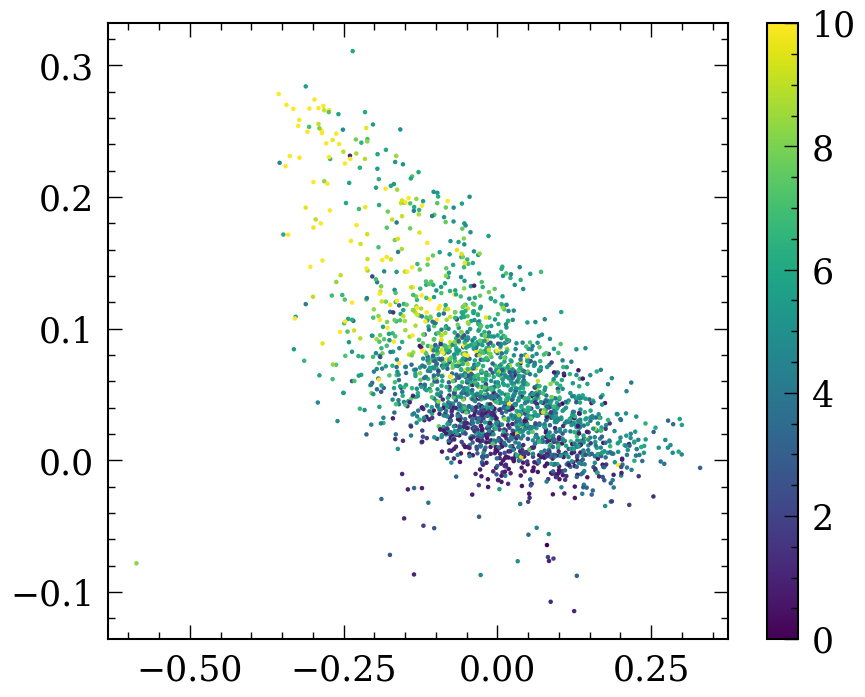

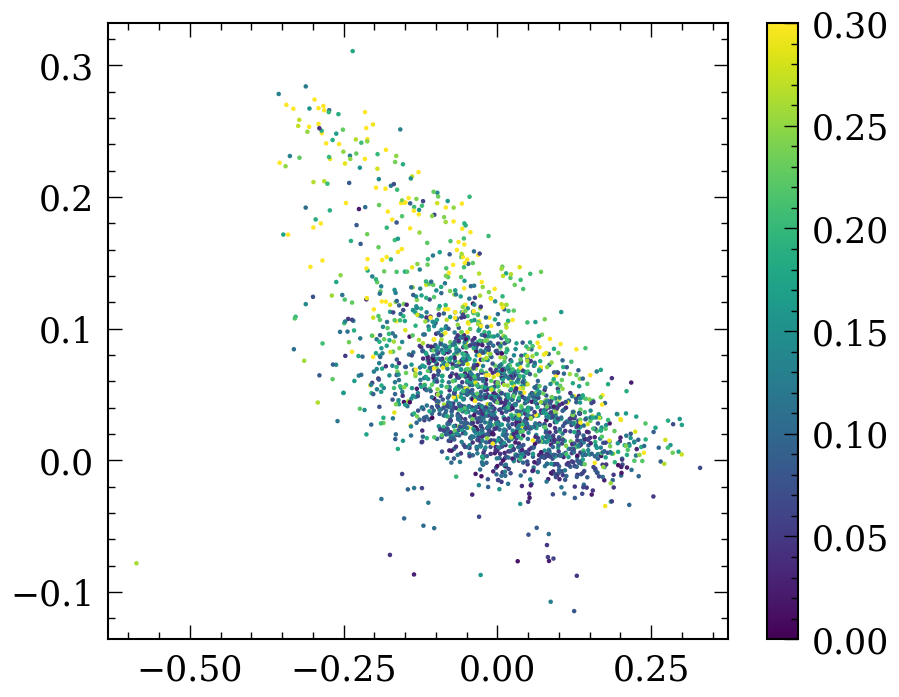

In [10]:
plt.figure(figsize=(10,8))
plt.scatter(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            c=ZTF['Age'], vmin=0, vmax=10, s=5)
"""plt.hexbin(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            C=ZTF['Age'], vmin=0, vmax=10, reduce_C_function=max)"""
plt.colorbar()

plt.figure(figsize=(10,8))
plt.scatter(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            c=ZTF['e'], vmin=0, vmax=0.3, s=5)
"""plt.hexbin(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            C=ZTF['Age'], vmin=0, vmax=10, reduce_C_function=max)"""
plt.colorbar()


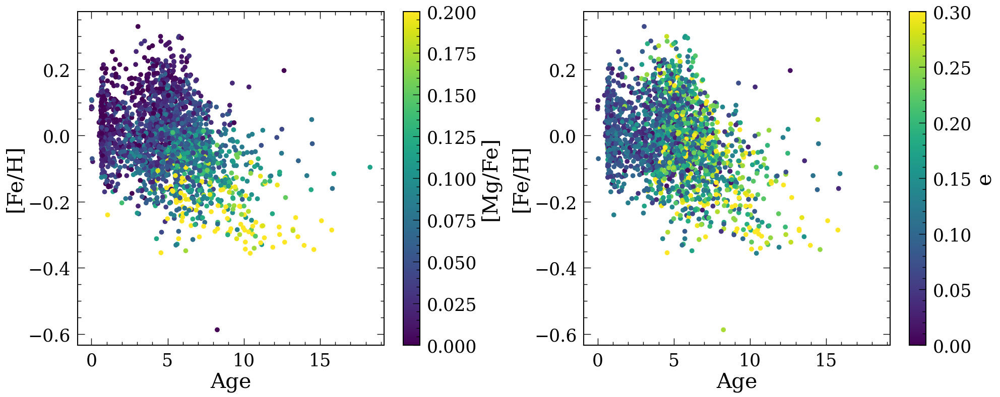

In [11]:
plt.figure(figsize=(20,8))
plt.subplot(1,2,1)
plt.scatter(ZTF['Age'], ZTF['fe_h_cannon'], 
            c=ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            vmin=0, vmax=0.2)
plt.xlabel('Age')
plt.ylabel('[Fe/H]')
plt.colorbar(label='[Mg/Fe]')

plt.subplot(1,2,2)
plt.scatter(ZTF['Age'], ZTF['fe_h_cannon'], 
            c=ZTF['e'], 
            vmin=0, vmax=0.3)
plt.xlabel('Age')
plt.ylabel('[Fe/H]')
plt.colorbar(label='e')
plt.tight_layout()

Text(0, 0.5, '[Mg/Fe]')

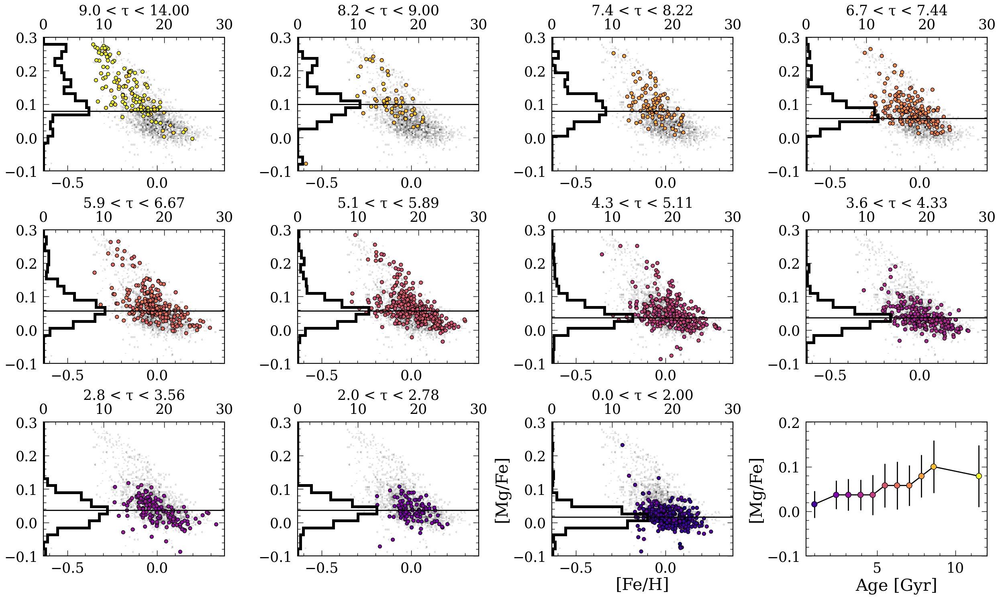

In [12]:
#agebins = [14, 9, 8, 7, 6, 5, 4, 3, 2, 0]
agebins = np.linspace(9,2,10)
agebins = np.append([14], agebins)
agebins = np.append(agebins, 0)
colors = getcolor(agebins)

maxfeh = np.zeros(len(agebins)-1)
stds = np.zeros(len(agebins)-1)
for i in range(len(agebins)-1):
    m = ((ZTF['Age']>agebins[i+1])&(ZTF['Age']<agebins[i]))
    x, y = np.histogram(ZTF['mg_h_cannon'][m]-ZTF['fe_h_cannon'][m],
                       bins=np.linspace(-0.1, 0.3, 20))
    y = y[1:]/2+y[:-1]/2
    maxfeh[i] = y[np.argmax(x)]
    stds[i] = np.std(ZTF['mg_h_cannon'][m]-ZTF['fe_h_cannon'][m])
    
plt.figure(figsize=(25,15))
for i in range(len(agebins)-1):
    plt.subplot(3,4,i+1)
    plt.hexbin(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'],
              cmap='binary')
    plt.title('%.1f < τ < %.2f'%(agebins[i+1], agebins[i]), fontsize=25)
    m = ((ZTF['Age']>agebins[i+1])&(ZTF['Age']<agebins[i]))
    plt.scatter(ZTF['fe_h_cannon'][m], ZTF['mg_h_cannon'][m]-ZTF['fe_h_cannon'][m], 
                c=ZTF['Age'][m], vmin=0, vmax=10, s=40, edgecolor='k', 
               cmap='plasma')
    plt.ylim([-0.1, 0.3])
    if i==len(agebins)-2:
        #plt.colorbar()
        plt.xlabel('[Fe/H]')
        plt.ylabel('[Mg/Fe]')
        
    plt.twiny()
    plt.hist(ZTF['mg_h_cannon'][m]-ZTF['fe_h_cannon'][m],
            histtype='step', linewidth=5, bins=np.linspace(-0.1, 0.3, 20),
            color='k', orientation='horizontal', density=True)
    plt.xlim([0, 30])
    
    plt.hlines(maxfeh[i], 0, 30, color='k')
    
        
    plt.tight_layout()
    
plt.subplot(3,4,len(agebins))
agebins = np.array(agebins)
plt.errorbar(agebins[1:]/2+agebins[:-1]/2, maxfeh, 
             yerr=stds,
        fmt='k-', zorder=1)
plt.ylim([-0.1, 0.2])
plt.scatter(agebins[1:]/2+agebins[:-1]/2, maxfeh, 
        c=agebins[1:]/2+agebins[:-1]/2,
           vmin=0, vmax=10, s=100, edgecolor='k', zorder=2,
           cmap='plasma')
plt.xlabel('Age [Gyr]')
plt.ylabel('[Mg/Fe]')


array([13.33333333, 12.        , 10.66666667,  9.33333333,  8.        ,
        6.66666667,  5.33333333,  4.        ,  2.66666667,  1.        ])

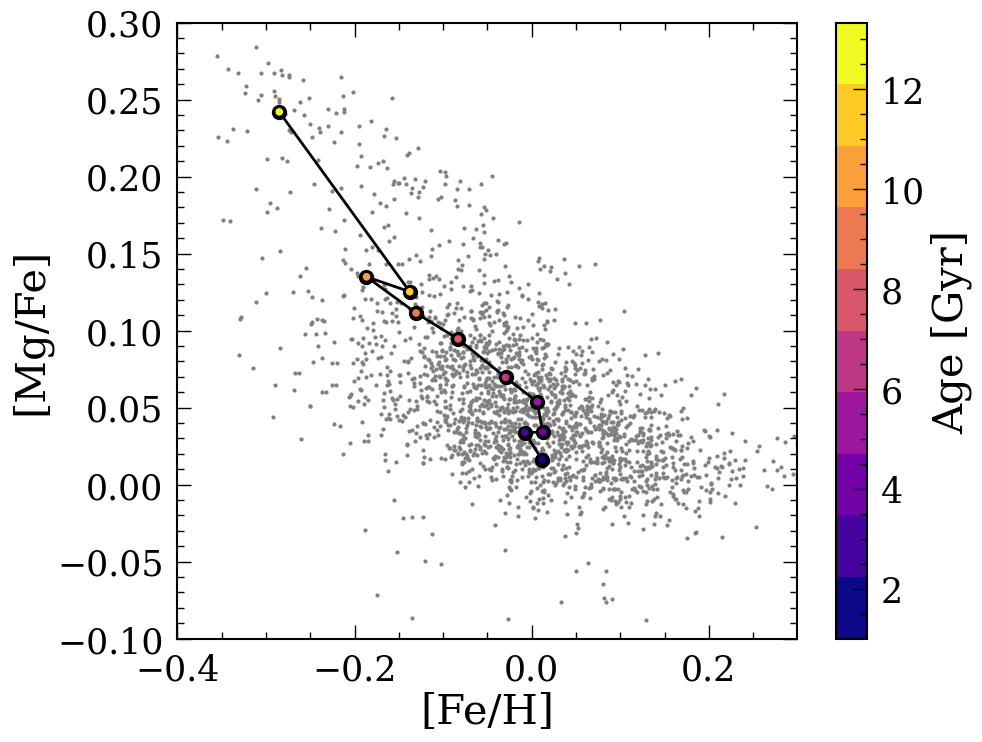

In [13]:
#agebins = [14, 9, 8, 7, 6, 5, 4, 3, 2, 0]
agebins = np.linspace(14,2,10)
agebins = np.append(agebins, 0)
colors = getcolor(agebins)
meanfeh = np.zeros(len(agebins)-1)
meanmgfe = np.zeros(len(agebins)-1)

maxfeh = np.zeros(len(agebins)-1)
stds = np.zeros(len(agebins)-1)
for i in range(len(agebins)-1):
    m = ((ZTF['Age']>agebins[i+1])&(ZTF['Age']<agebins[i]))
    ztf_sing = ZTF[m]
    meanfeh[i] = np.median(ztf_sing['fe_h_cannon'].dropna())
    meanmgfe[i] = np.median((ztf_sing['mg_h_cannon']-ztf_sing['fe_h_cannon']).dropna())

    
plt.figure(figsize=(10,8))
plt.plot(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'],
         'o', color='grey', zorder=1, ms=2)
agebins = np.array(agebins)
plt.plot(meanfeh, meanmgfe, 'k-o', zorder=1, ms=10)
plt.ylim([-0.1, 0.3])
plt.scatter(meanfeh, meanmgfe, c=agebins[1:]/2+agebins[:-1]/2, 
            s=20, zorder=2, cmap=plt.get_cmap('plasma', len(agebins)-1))
plt.xlabel('[Fe/H]')
plt.ylabel('[Mg/Fe]')
plt.colorbar(label='Age [Gyr]')
plt.xlim([-0.4, 0.3])
agebins[1:]/2+agebins[:-1]/2

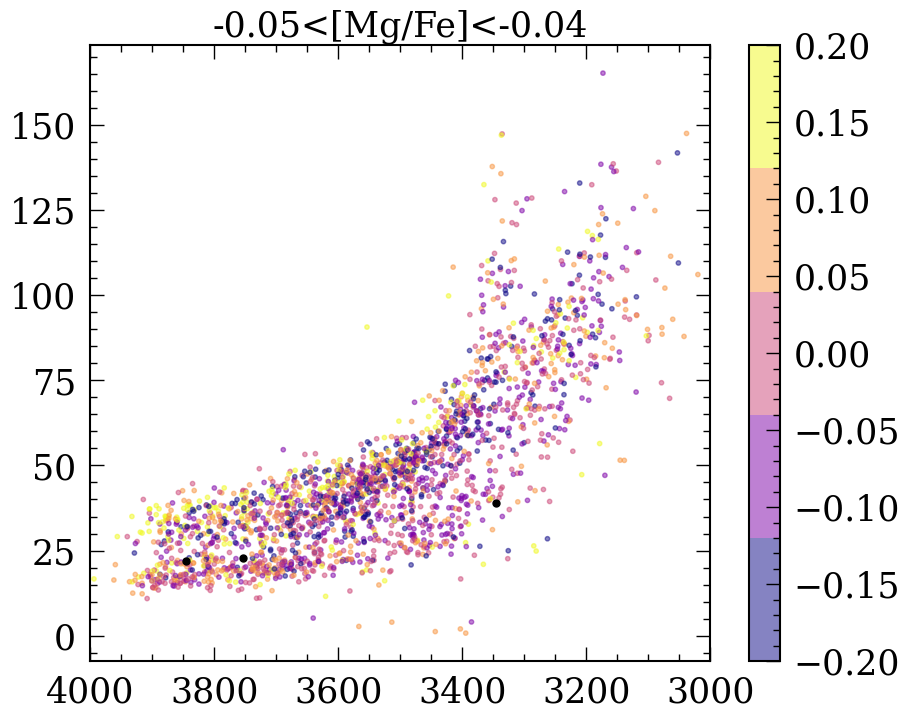

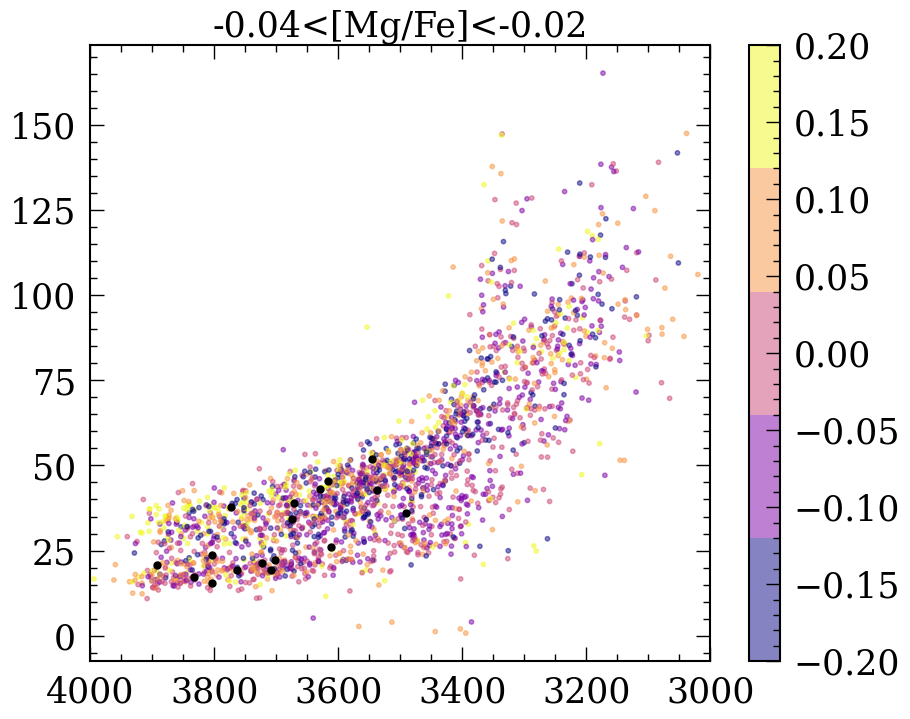

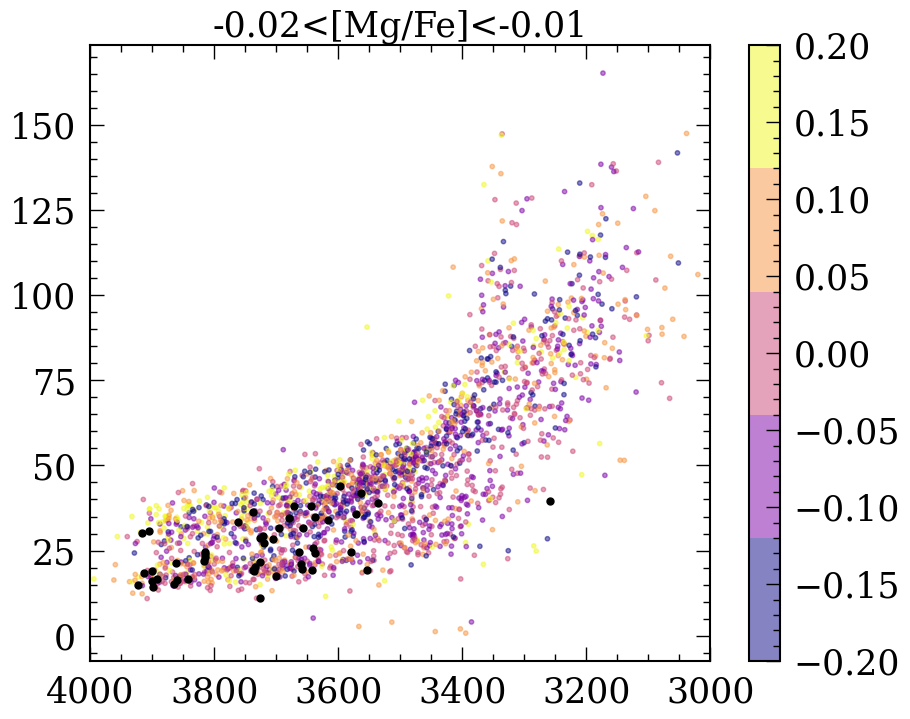

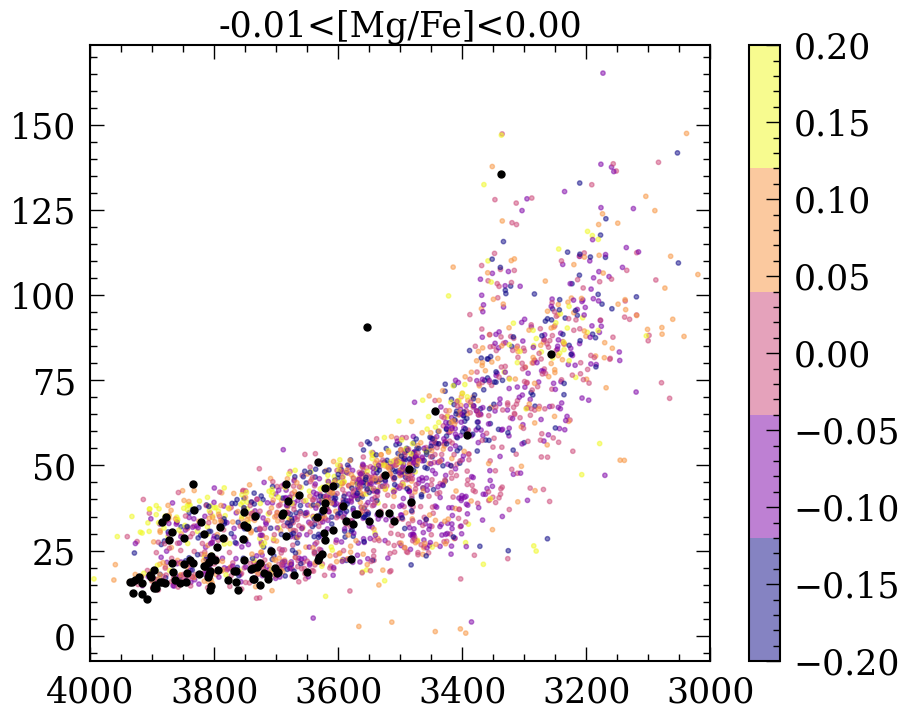

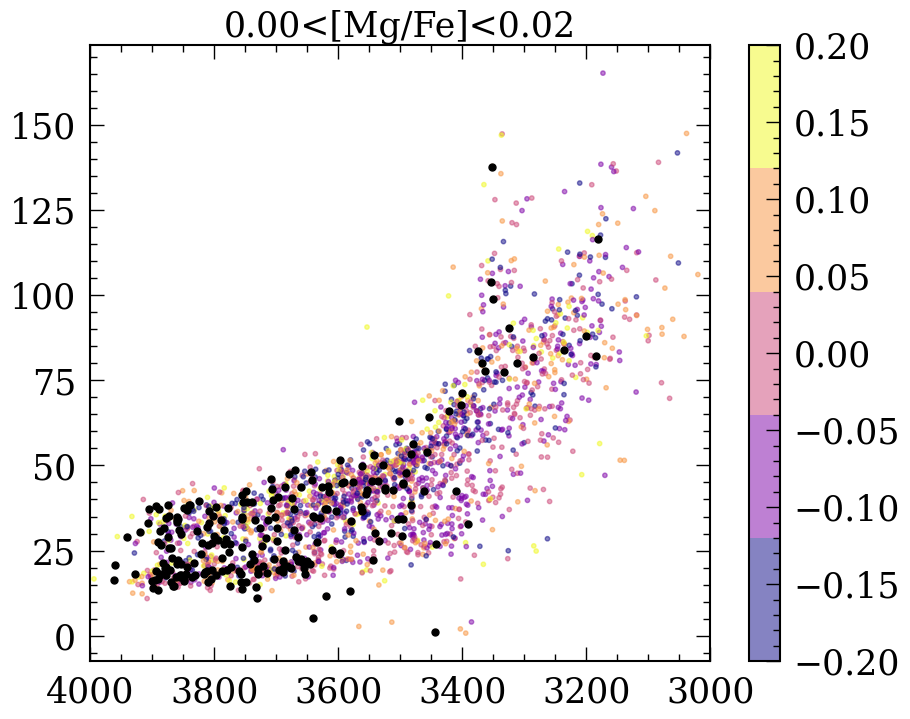

...

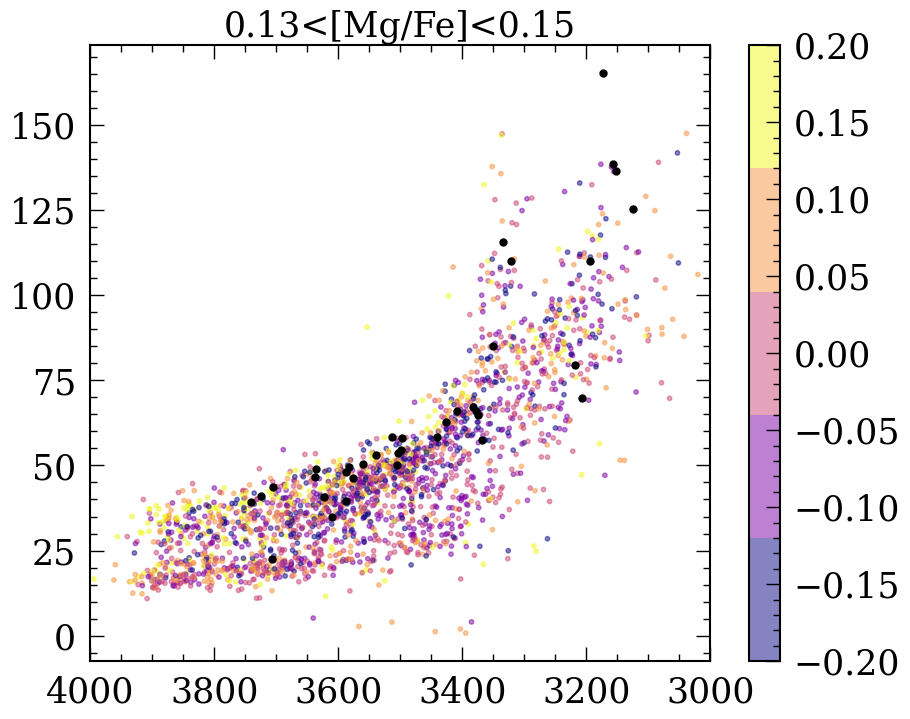

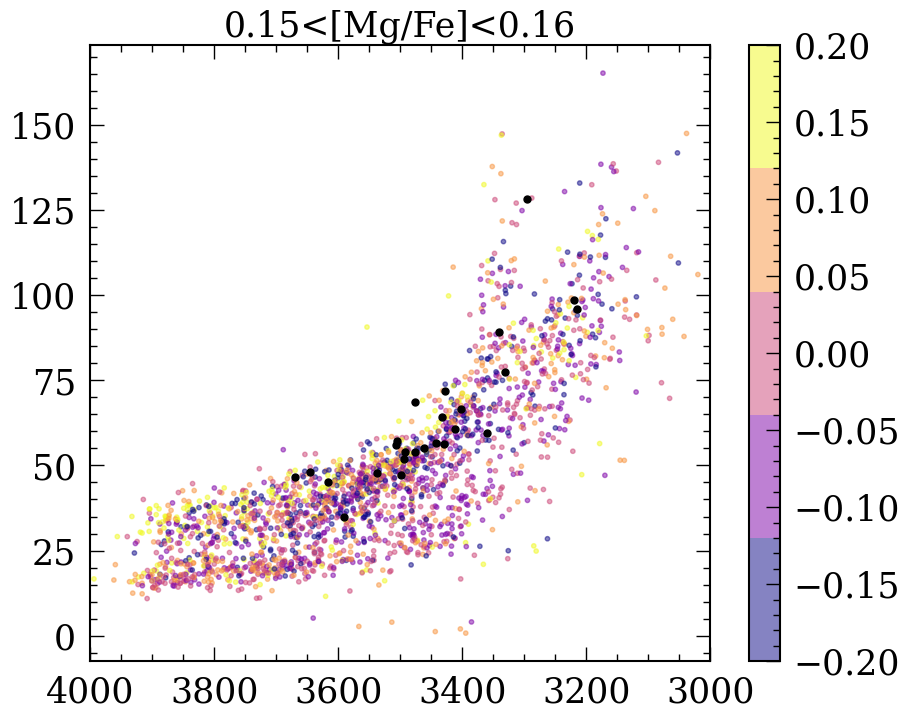

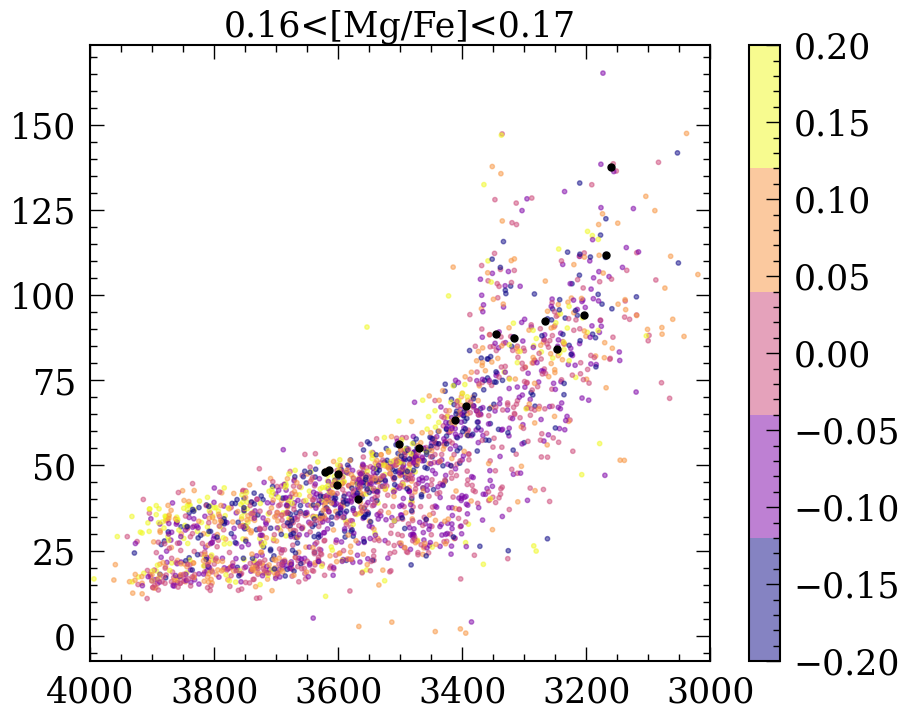

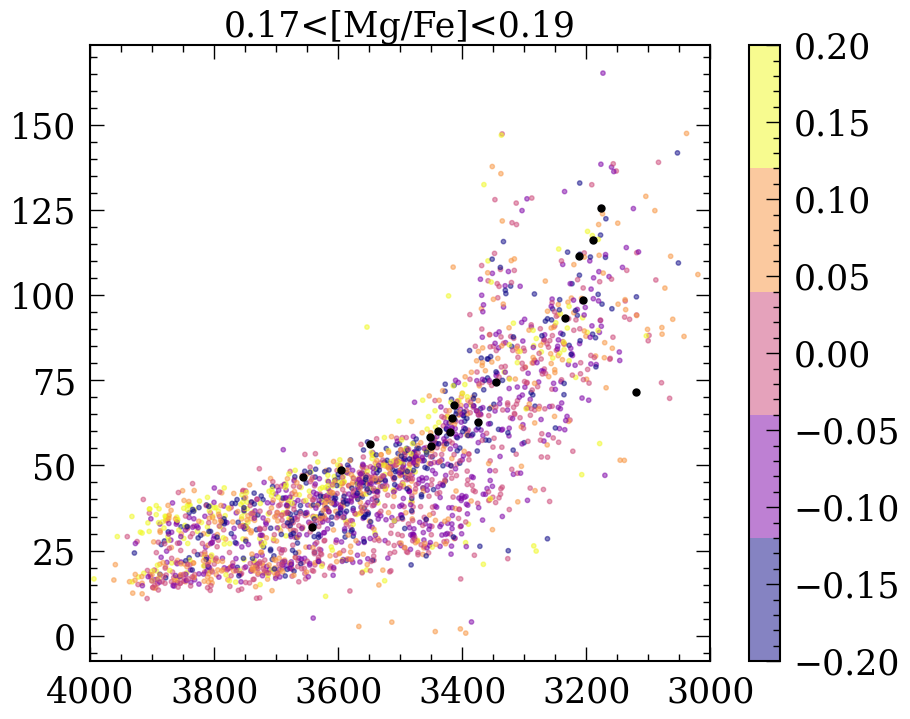

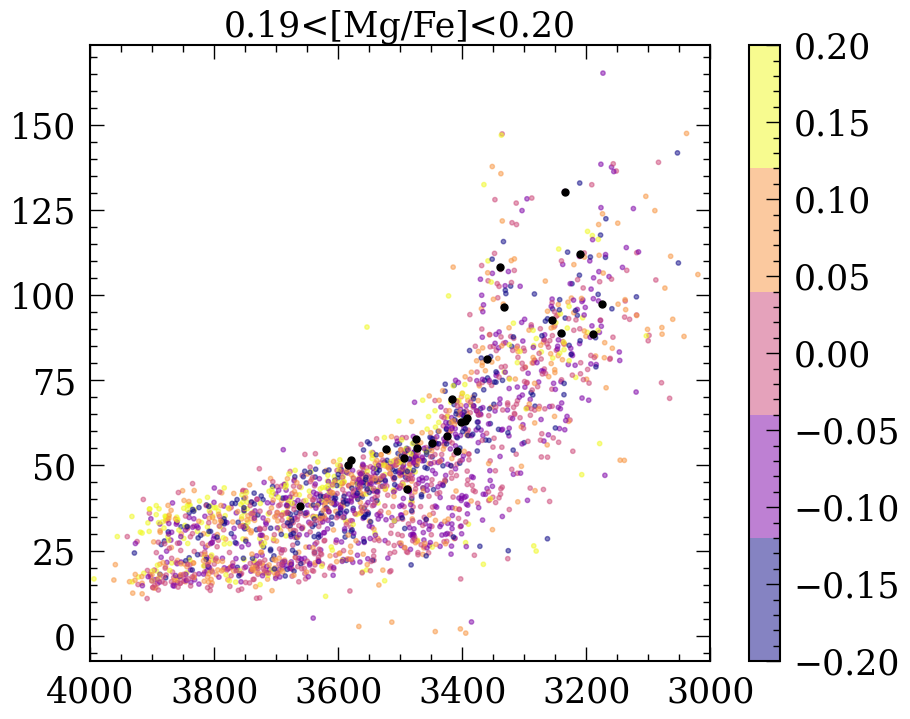

In [14]:
alphabin = np.linspace(-0.05, 0.2, 20)
for i in range(len(alphabin)-1):
    plt.figure(figsize=(10,8))
    plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], 
                vmin=-0.2, vmax=0.2, cmap=plt.get_cmap('plasma', 5), alpha=0.5)
    m_ha = (((ZTF['mg_h_cannon']-ZTF['fe_h_cannon'])>alphabin[i])&(((ZTF['mg_h_cannon']-ZTF['fe_h_cannon'])<alphabin[i+1])))
    plt.plot(ZTF['teff_y'][m_ha], ZTF['Prot'][m_ha], 'ko', markersize=5)

    plt.xlim([4000, 3000])
    plt.title('%.2f<[Mg/Fe]<%.2f'%(alphabin[i], alphabin[i+1]), fontsize=25)
    plt.colorbar()


"m = ((ZTF['teff_y']>3700)&(ZTF['teff_y']<3800))\nplt.scatter(ZTF['Prot'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], \n            c=ZTF['teff_y'], vmin=3000, vmax=4000, )\nplt.xlabel('Prot')\nplt.ylabel('[Mg/Fe]')"

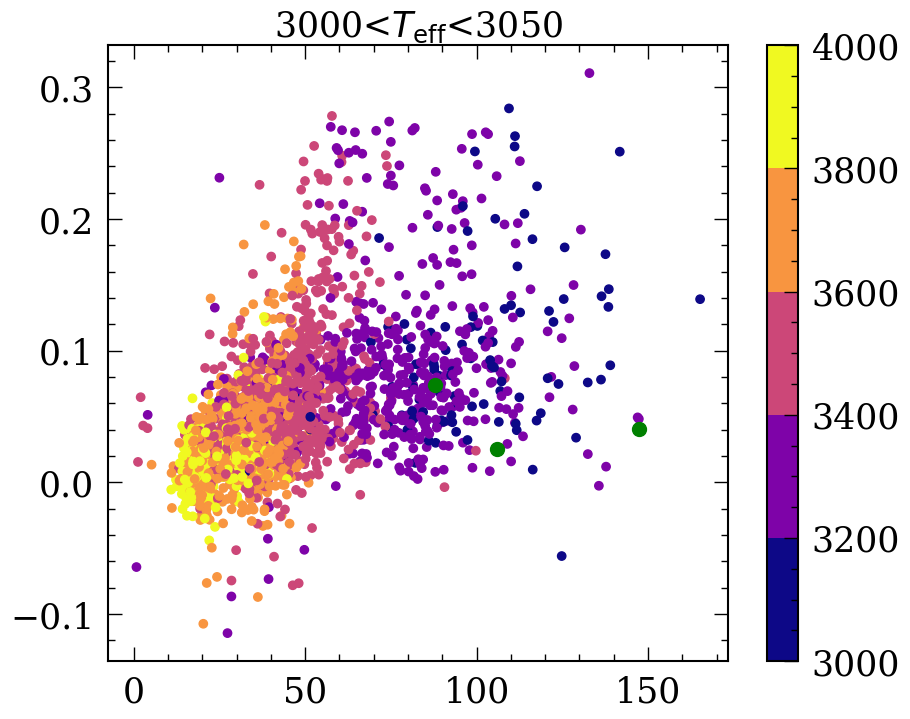

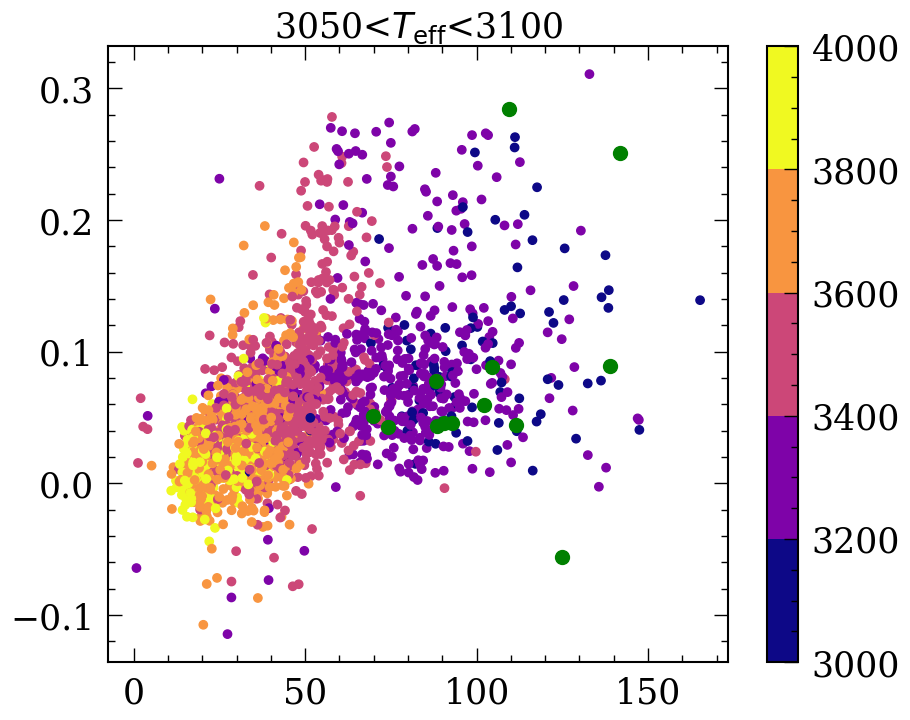

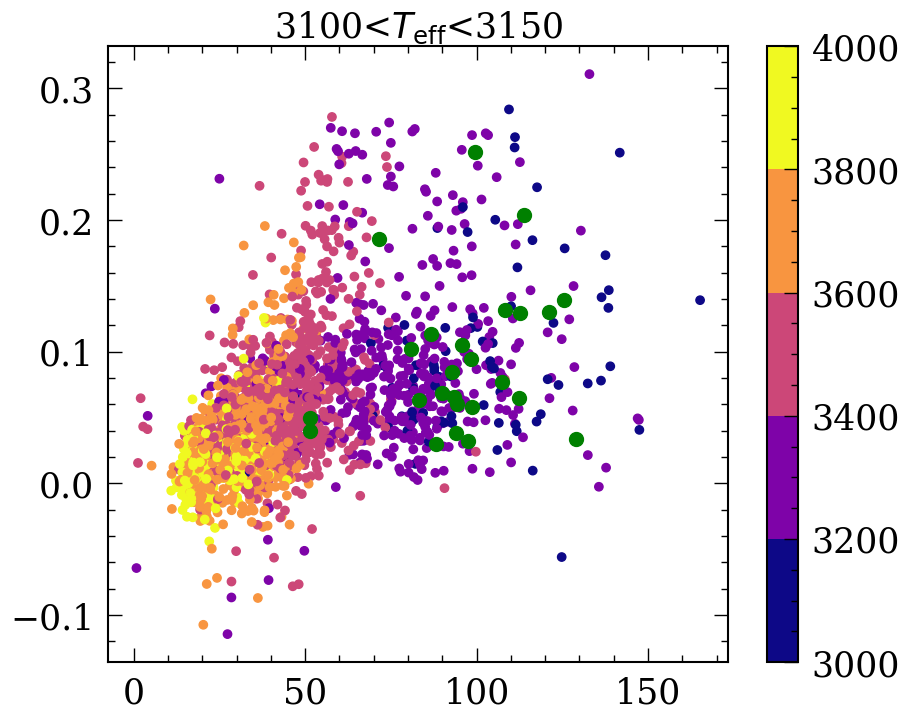

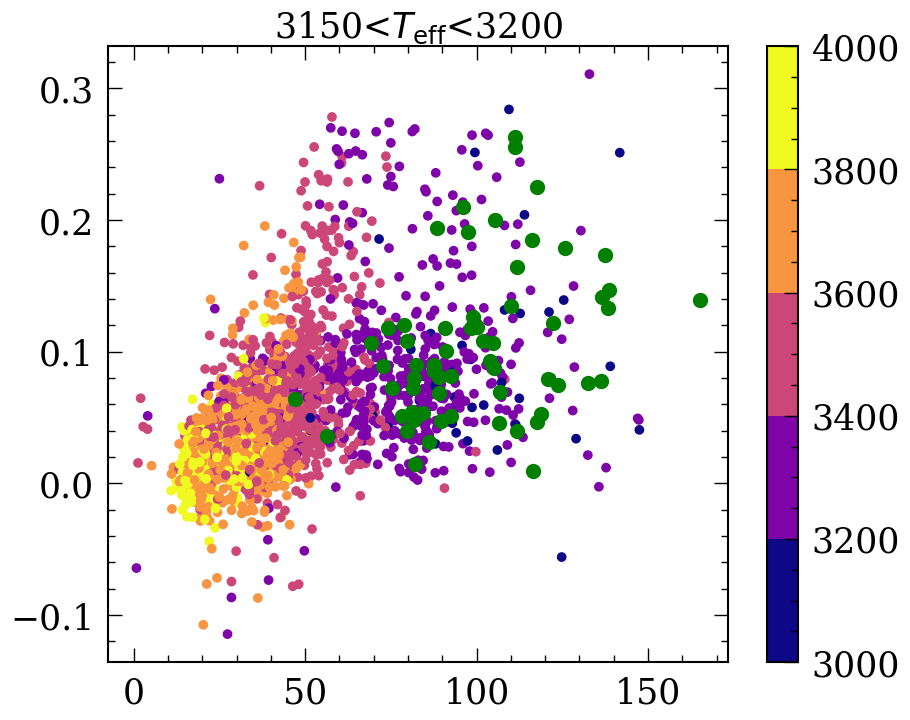

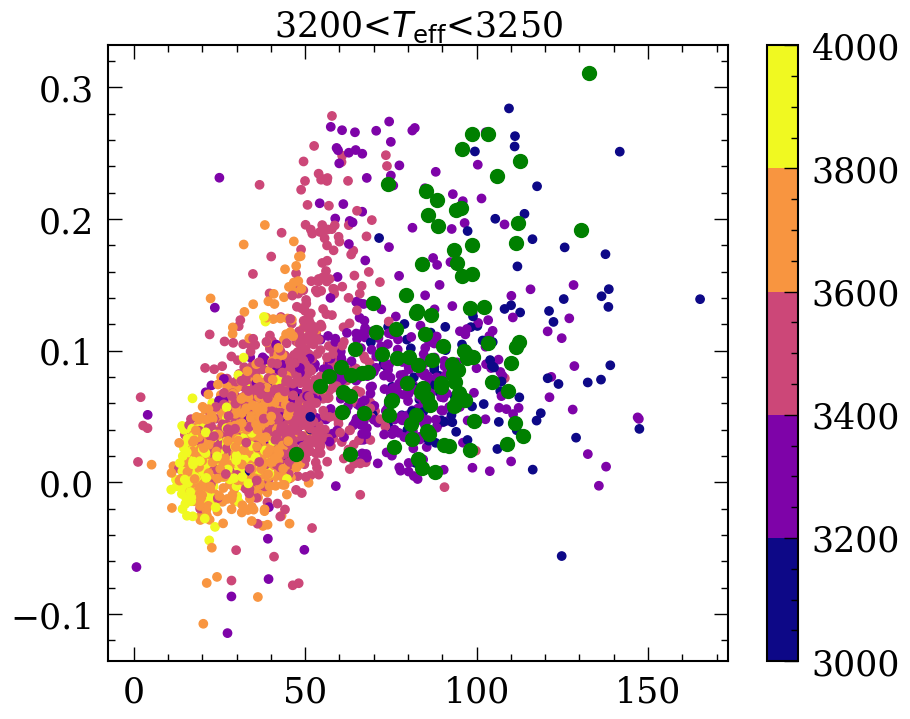

...

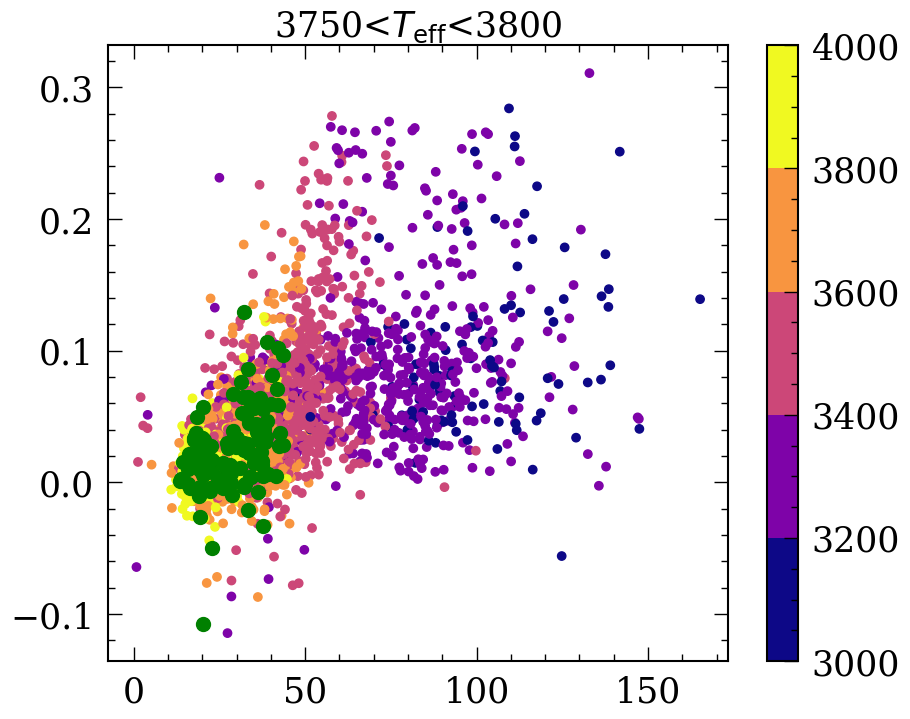

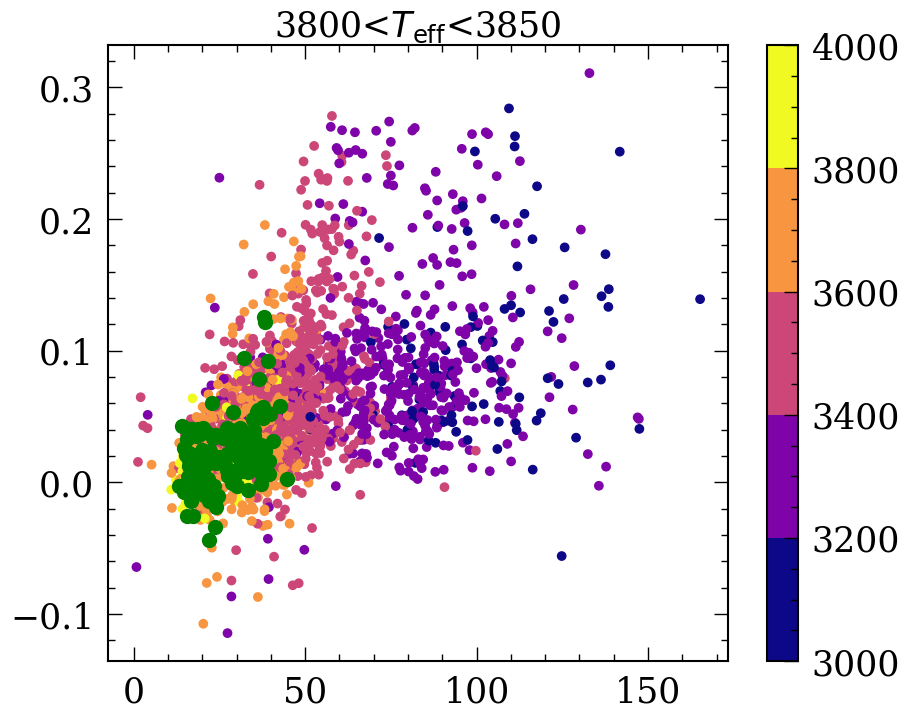

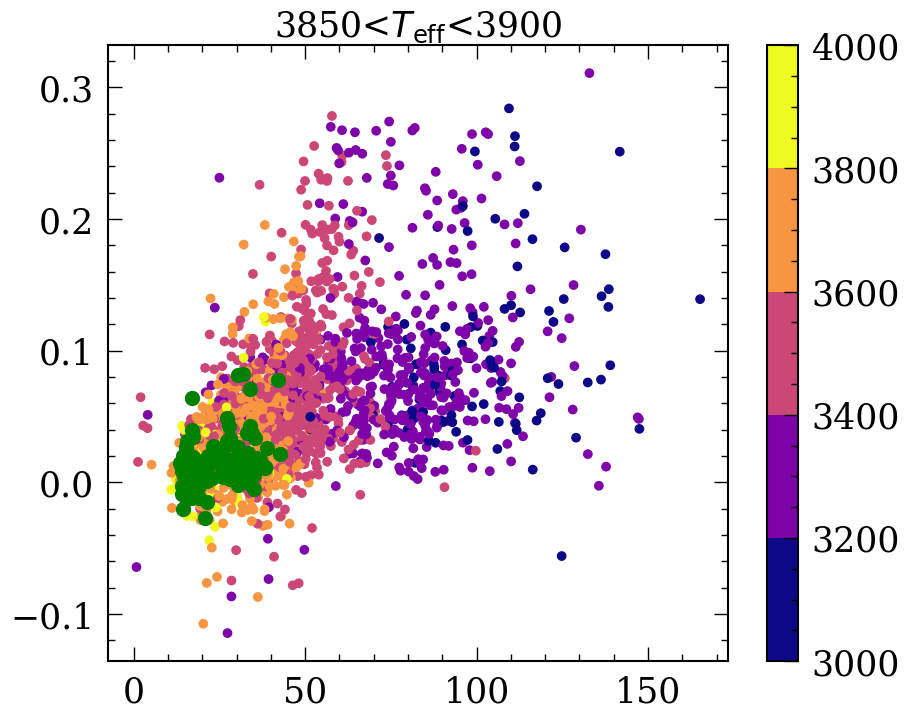

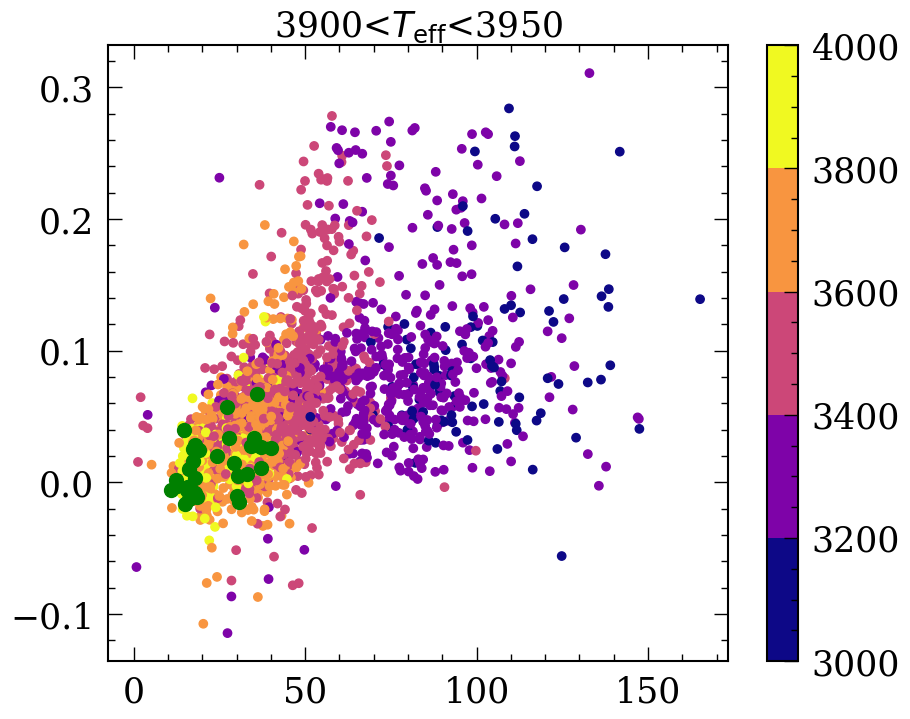

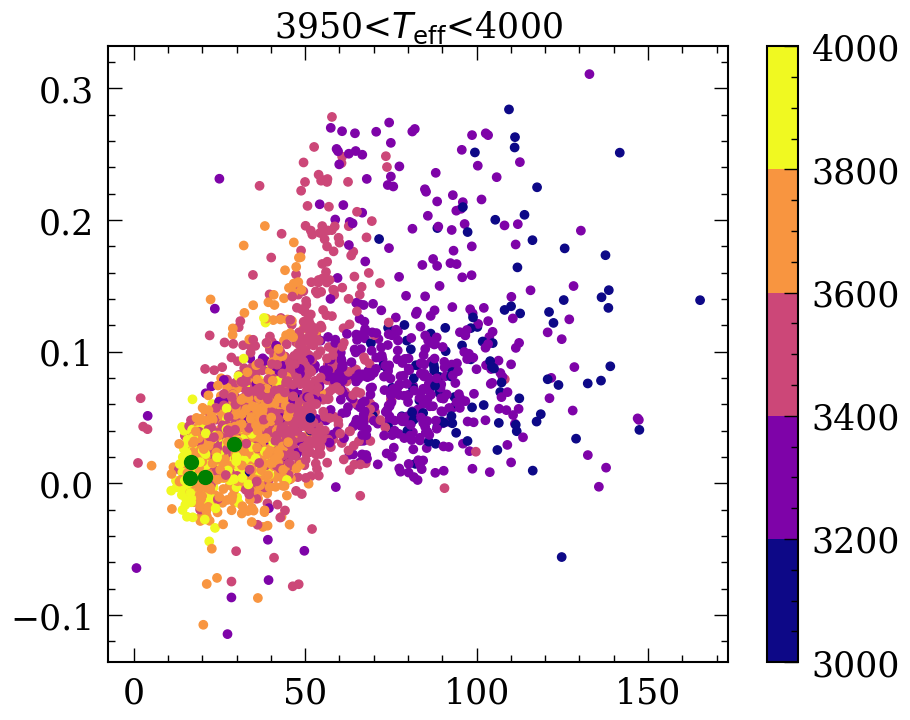

In [15]:
teffbin = np.linspace(3000, 4000, 21)
for i in range(len(teffbin)-1):
    plt.figure(figsize=(10,8))
    plt.scatter(ZTF['Prot'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
                c=ZTF['teff_y'], vmin=3000, vmax=4000,
               cmap=plt.get_cmap('plasma', 5))
    m = ((ZTF['teff_y']>teffbin[i])&(ZTF['teff_y']<teffbin[i+1]))
    plt.plot(ZTF['Prot'][m], (ZTF['mg_h_cannon']-ZTF['fe_h_cannon'])[m], 
             'go', markersize=10)
    plt.title('%d<$T_{\\rm eff}$<%d'%(teffbin[i], teffbin[i+1]), fontsize=25)
    plt.colorbar()

"""m = ((ZTF['teff_y']>3700)&(ZTF['teff_y']<3800))
plt.scatter(ZTF['Prot'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            c=ZTF['teff_y'], vmin=3000, vmax=4000, )
plt.xlabel('Prot')
plt.ylabel('[Mg/Fe]')"""

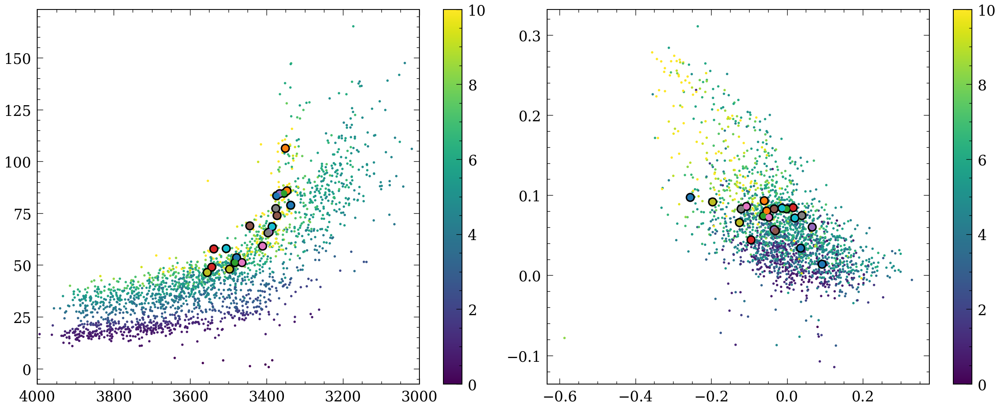

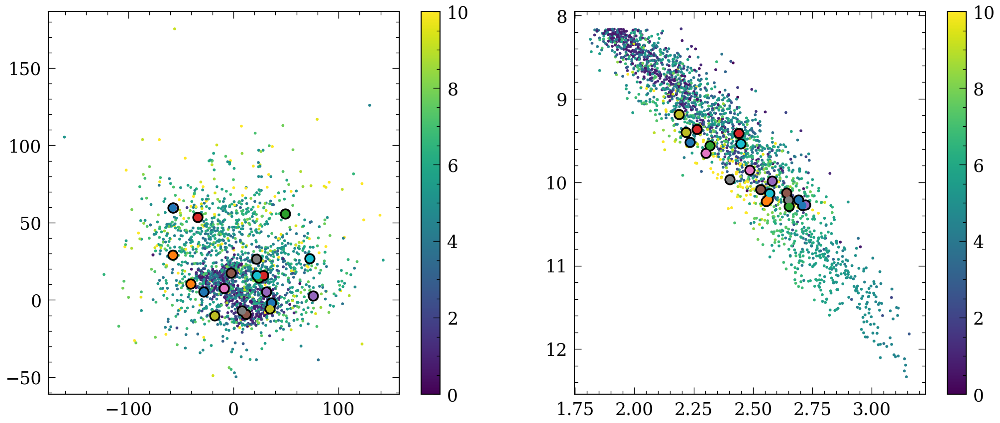

In [16]:
ZTF_confstar = [2198551981690094208, 506451106055526144, 1650006833169924224, 
               1284212268230178688, 1533855902279990272, 1272757865330819712, 
               1643551566043342592, 3847814028861146880]

ZTF_confstar2 = [918199175354371072, 479744449646825600, 2212740835637668480, 
                 1090979486268686080,3302438428781887872, 1565197687389215616, 
                 1647546985140349184, 3808629942708336512,1461250854531651968, 
                 4516590911335828352, 251831391612345600, 3961863002756255872, 
                 3945282814086494464]

ZTF_confstar = ZTF_confstar+ZTF_confstar2

ZTF['vphi'], ZTF['vr'], ZTF['vz'] = vxvyvz_to_vphivrvz(ZTF['x'], ZTF['y'], ZTF['z'], ZTF['vx'], ZTF['vy'], ZTF['vz'])

ztf_old = ZTF.loc[(ZTF['Age']>8)&((ZTF['mg_h_cannon']-ZTF['fe_h_cannon'])<0.1)]

#ztf_old = ztf_old.loc[ztf_old['teff_y']>3400]

ztf_old = ztf_old.loc[ztf_old['source_id_x'].isin(ZTF_confstar)]
plt.figure(figsize=(25, 10))
plt.subplot(1,2,1)
plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['teff_y'], ztf_old['Prot'], 'ko', markersize=15)

for i in range(len(ztf_old)):
    plt.plot(ztf_old['teff_y'].iloc[i], ztf_old['Prot'].iloc[i], 'o', markersize=10)
plt.xlim([4000, 3000])
plt.colorbar()

plt.subplot(1,2,2)
plt.scatter(ZTF['fe_h_cannon'], 
            ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['fe_h_cannon'], 
             ztf_old['mg_h_cannon']-ztf_old['fe_h_cannon'], 
             'ko', markersize=15)
for i in range(len(ztf_old)):
    plt.plot(ztf_old['fe_h_cannon'].iloc[i], 
             ztf_old['mg_h_cannon'].iloc[i]-ztf_old['fe_h_cannon'].iloc[i], 
             'o', markersize=10)
plt.tight_layout()
plt.colorbar()

plt.figure(figsize=(25, 10))
plt.subplot(1,2,1)
plt.scatter(ZTF['vr'], ZTF['vphi']+240, s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['vr'], ztf_old['vphi']+240, 'ko',
            markersize=15)
for i in range(len(ztf_old)):
    plt.plot(ztf_old['vr'].iloc[i], ztf_old['vphi'].iloc[i]+240, 'o',
            markersize=10)
plt.colorbar()

plt.subplot(1,2,2)
plt.scatter(ZTF['bprp_dered'], ZTF['abs_G'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['bprp_dered'], ztf_old['abs_G'], 'ko', markersize=15)
for i in range(len(ztf_old)):
    plt.plot(ztf_old['bprp_dered'].iloc[i], ztf_old['abs_G'].iloc[i], 
             'o', markersize=10)
plt.gca().invert_yaxis()
plt.colorbar()

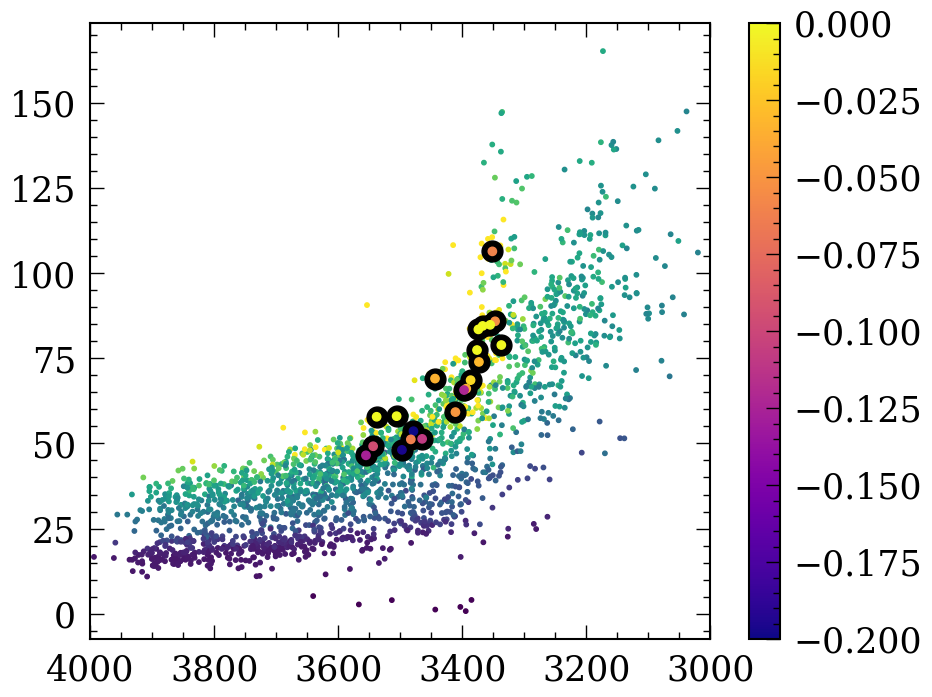

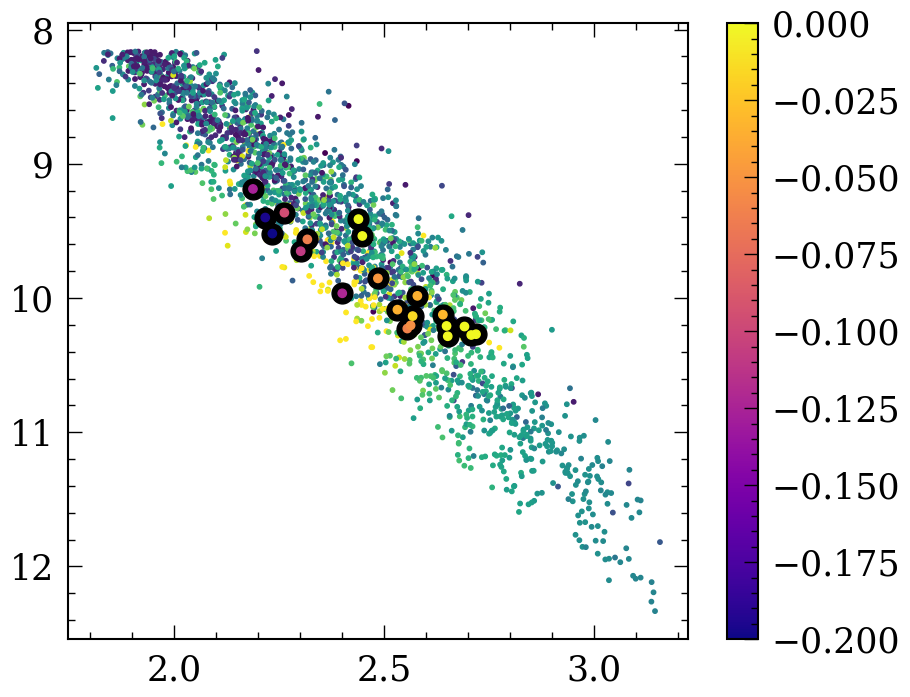

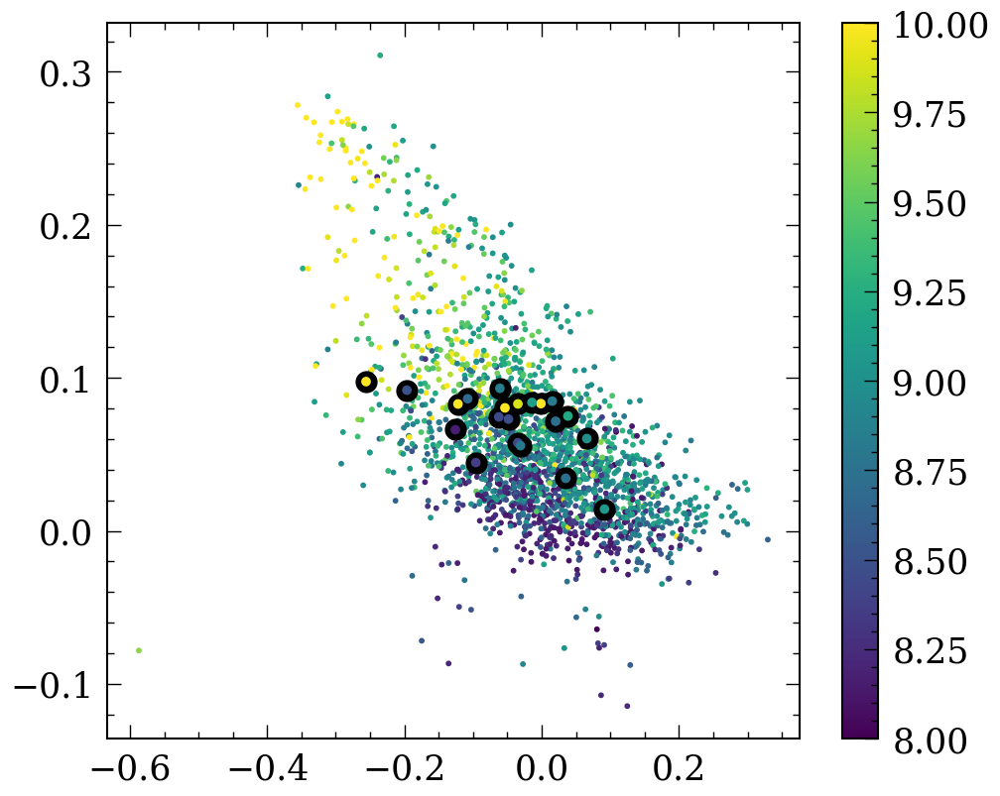

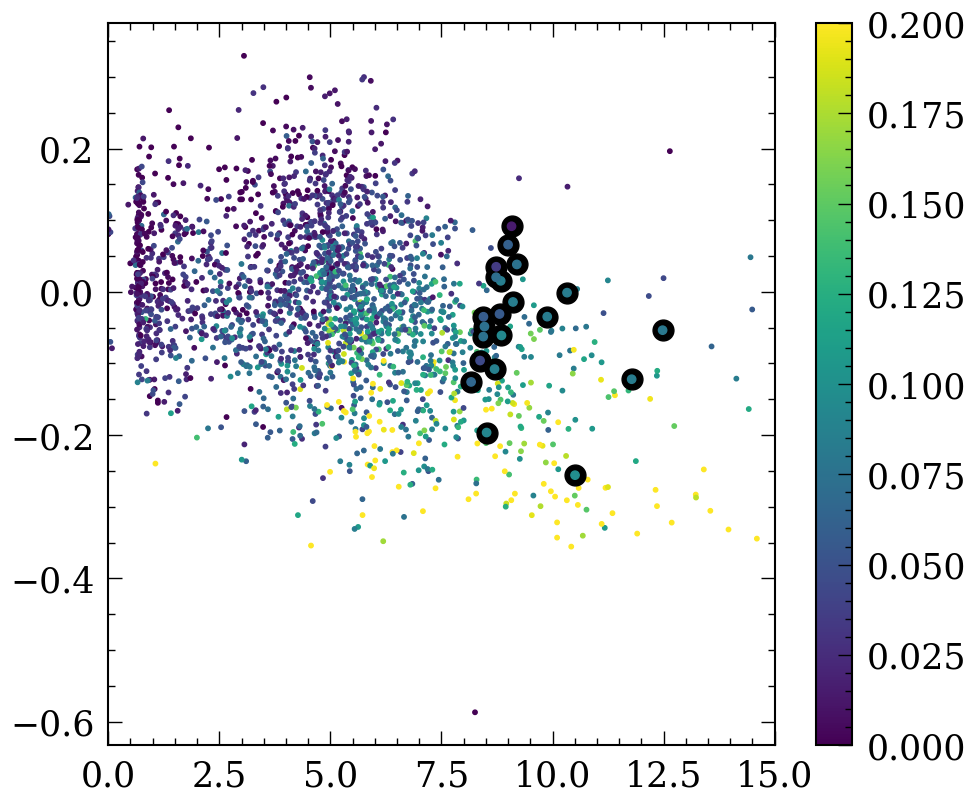

In [17]:
plt.figure(figsize=(10,8))
plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['teff_y'], ztf_old['Prot'], 'ko', markersize=15,
        zorder=1)
plt.scatter(ztf_old['teff_y'], ztf_old['Prot'],
           c=ztf_old['fe_h_cannon'], cmap='plasma', zorder=2,
           vmin=-0.2, vmax=0)

plt.xlim([4000, 3000])
plt.colorbar()

plt.figure(figsize=(10,8))
plt.scatter(ZTF['bprp_dered'], ZTF['abs_G'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['bprp_dered'], ztf_old['abs_G'], 'ko', markersize=15,
        zorder=1)
plt.scatter(ztf_old['bprp_dered'], ztf_old['abs_G'],
            c=ztf_old['fe_h_cannon'], cmap='plasma', zorder=2,
           vmin=-0.2, vmax=0)
plt.gca().invert_yaxis()
plt.colorbar()


plt.figure(figsize=(10,8))
plt.scatter(ZTF['fe_h_cannon'], 
            ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['fe_h_cannon'], 
             ztf_old['mg_h_cannon']-ztf_old['fe_h_cannon'], 
             'ko', markersize=15, zorder=1)
plt.scatter(ztf_old['fe_h_cannon'], 
             ztf_old['mg_h_cannon']-ztf_old['fe_h_cannon'], 
         c=ztf_old['Age'], zorder=2, vmin=8, vmax=10)
plt.tight_layout()
plt.colorbar()

plt.figure(figsize=(10,8))
plt.scatter(ZTF['Age'], 
            ZTF['fe_h_cannon'], 
            s=10, c=ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            vmin=0, vmax=0.2)
plt.plot(ztf_old['Age'], 
             ztf_old['fe_h_cannon'], 
             'ko', markersize=15, zorder=1)
plt.scatter(ztf_old['Age'], 
             ztf_old['fe_h_cannon'], 
         c=ztf_old['mg_h_cannon']-ztf_old['fe_h_cannon'], zorder=2,
            vmin=0, vmax=0.2)
plt.xlim([0,15])
plt.tight_layout()
plt.colorbar()

"plt.figure(figsize=(10,8))\nplt.scatter(ZTF['abs_G'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], \n            vmin=-0.2, vmax=0.2, cmap='plasma')\nplt.plot(ztf_old['abs_G'], ztf_old['Prot'], 'ko', markersize=15,\n        zorder=1)\nplt.scatter(ztf_old['abs_G'], ztf_old['Prot'],\n           c=ztf_old['fe_h_cannon'], cmap='plasma', zorder=2,\n           vmin=-0.2, vmax=0.2)\nplt.xlim([8, 12])\nplt.xlabel('$M_G$')\nplt.ylabel('$P_{\\rm rot}$ [days]')\nplt.colorbar(label='[Fe/H]')"

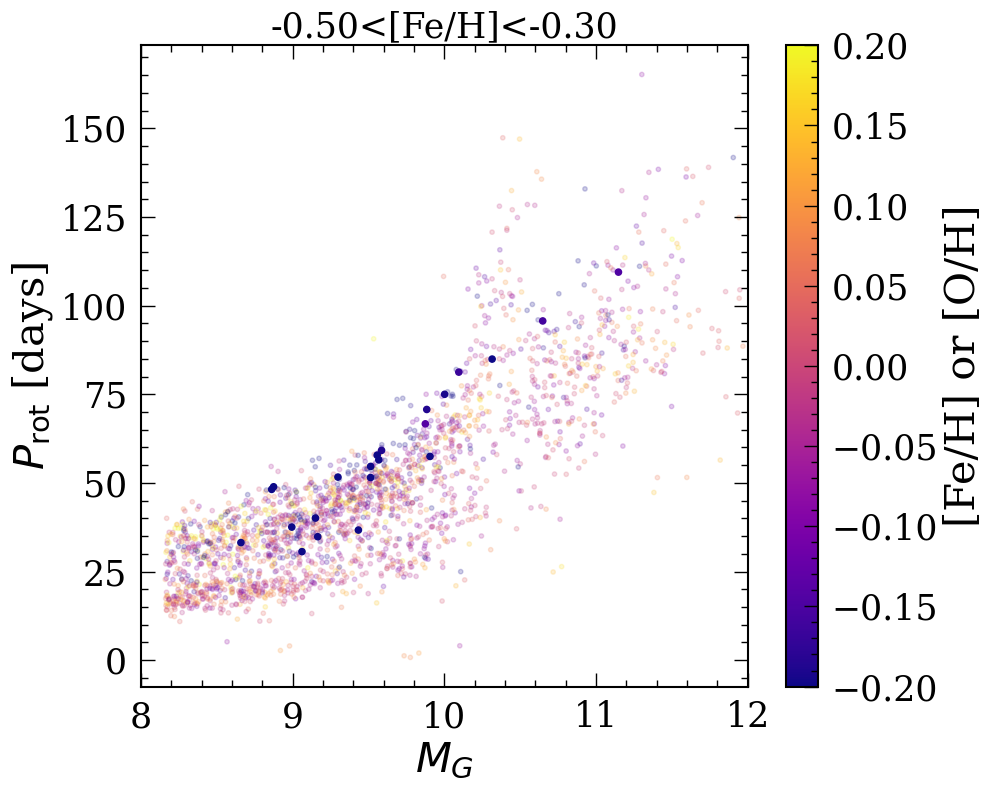

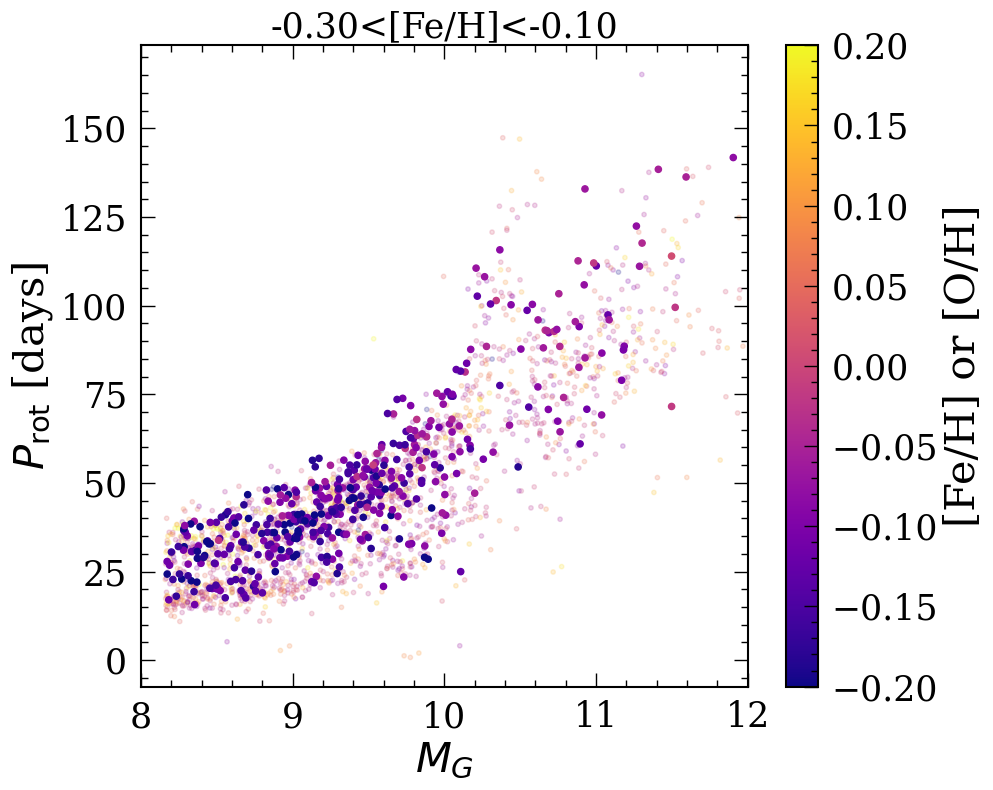

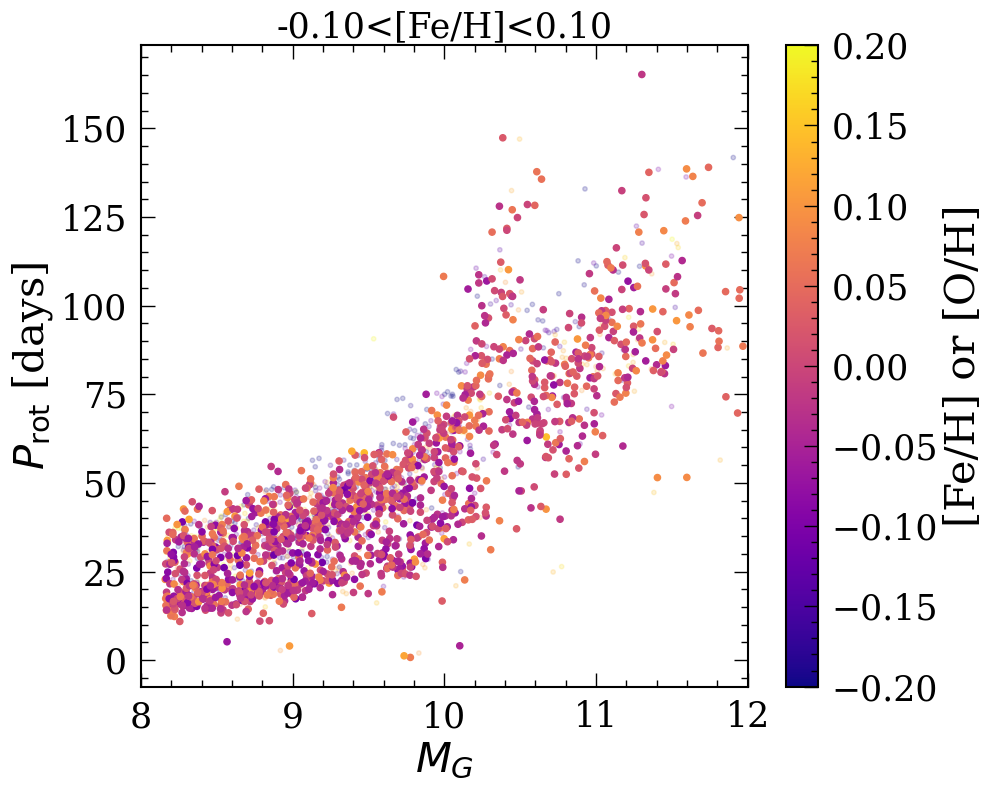

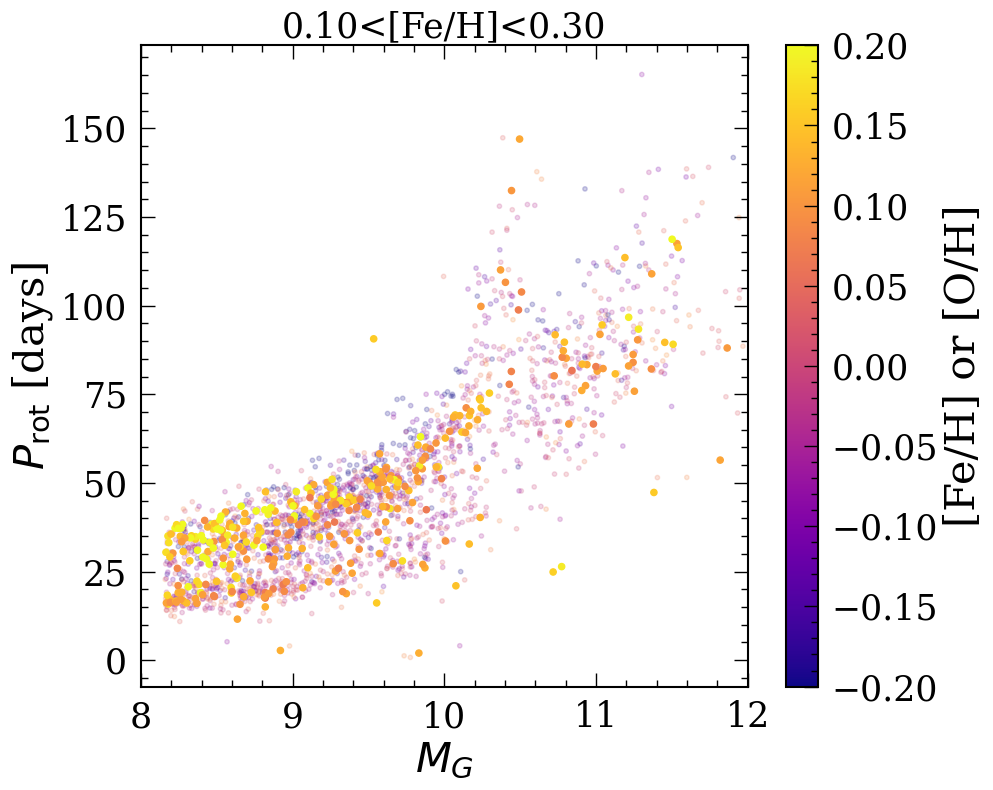

In [18]:
fehbin = np.linspace(-0.5,0.3,5)
for i in range(len(fehbin)-1):
    plt.figure(figsize=(10,8))
    plt.scatter(ZTF['abs_G'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], 
            vmin=-0.2, vmax=0.2, cmap='plasma', alpha=0.2, zorder=1)
    """plt.plot(ztf_old['abs_G'], ztf_old['Prot'], 'ko', markersize=15,
            zorder=1)
    plt.scatter(ztf_old['abs_G'], ztf_old['Prot'],
               c=ztf_old['fe_h_cannon'], cmap='plasma', zorder=2,
               vmin=-0.2, vmax=0.2)"""
    plt.xlim([8, 12])
    plt.xlabel('$M_G$')
    plt.ylabel('$P_{\\rm rot}$ [days]')
    m_ha = ((ZTF['fe_h_cannon']>fehbin[i])&(ZTF['fe_h_cannon']<fehbin[i+1]))
    #plt.plot(ZTF['abs_G'][m_ha], ZTF['Prot'][m_ha], 'go', markersize=4, zorder=1)
    plt.scatter(ZTF['abs_G'][m_ha], ZTF['Prot'][m_ha], 
                c=ZTF['o_h_cannon'][m_ha], s=20, zorder=2, 
                vmin=-0.2, vmax=0.2, cmap='plasma')
    plt.title('%.2f<[Fe/H]<%.2f'%(fehbin[i], fehbin[i+1]), fontsize=25)
    plt.colorbar(label='[Fe/H] or [O/H]')
    plt.tight_layout()
"""fehbin = np.linspace(-0.5,0.5,3)
for i in range(len(fehbin)-1):
    plt.figure(figsize=(10,8))
    plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], 
            vmin=-0.2, vmax=0.2, cmap='plasma', alpha=0.2)
    plt.xlim([4000, 3000])
    plt.xlabel('$T_{\\rm eff}$')
    plt.ylabel('$P_{\\rm rot}$ [days]')
    plt.colorbar(label='[Fe/H]')
    m_ha = ((ZTF['fe_h_cannon']>fehbin[i])&(ZTF['fe_h_cannon']<fehbin[i+1]))
    plt.plot(ZTF['teff_y'][m_ha], ZTF['Prot'][m_ha], 'go', markersize=5)

    plt.title('%.2f<[Fe/H]<%.2f'%(fehbin[i], fehbin[i+1]), fontsize=25)"""
    
"""plt.figure(figsize=(10,8))
plt.scatter(ZTF['abs_G'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], 
            vmin=-0.2, vmax=0.2, cmap='plasma')
plt.plot(ztf_old['abs_G'], ztf_old['Prot'], 'ko', markersize=15,
        zorder=1)
plt.scatter(ztf_old['abs_G'], ztf_old['Prot'],
           c=ztf_old['fe_h_cannon'], cmap='plasma', zorder=2,
           vmin=-0.2, vmax=0.2)
plt.xlim([8, 12])
plt.xlabel('$M_G$')
plt.ylabel('$P_{\\rm rot}$ [days]')
plt.colorbar(label='[Fe/H]')"""

(10, 200)

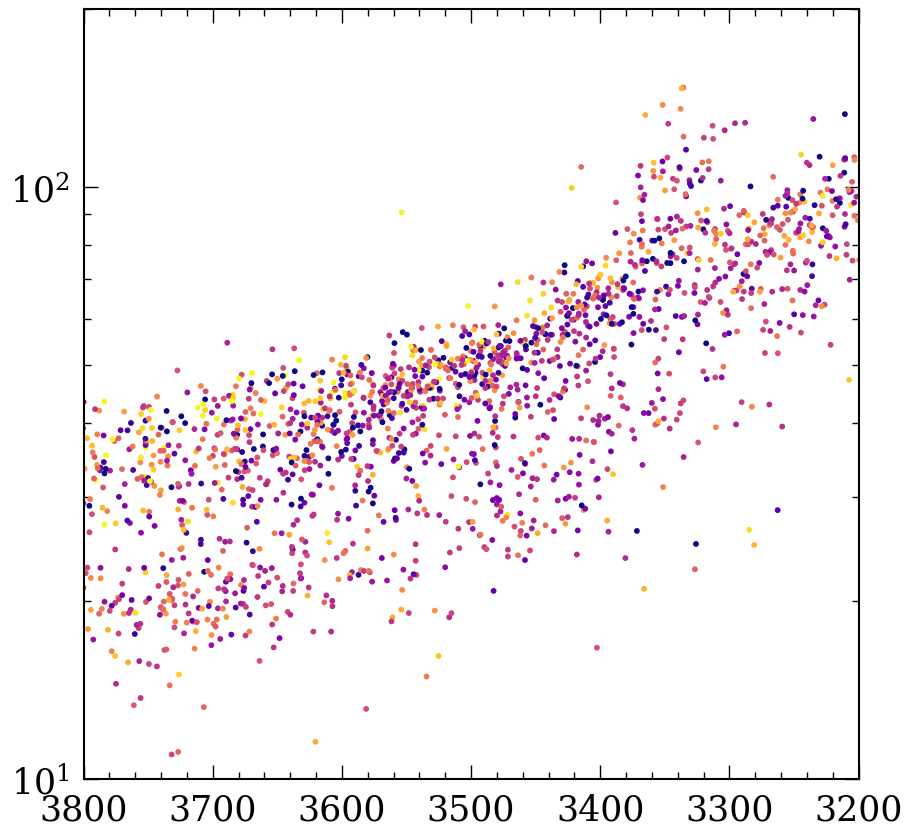

In [19]:
allztf = pd.read_csv('../NewGyroKineage/Tab2.csv')
#allztf['Ro'] = allztf['Prot']/tauc(allztf['teff'])
#ZTF['Ro'] = ZTF['Prot']/tauc(ZTF['teff_y'])
#plt.plot(allztf['teff'], allztf['Prot'], 'k.', zorder=1, ms=1, alpha=0.2)
plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], 
            vmin=-0.2, vmax=0.2, cmap='plasma', zorder=2)
plt.yscale('log')
plt.xlim([3800, 3200])
plt.ylim([10, 200])

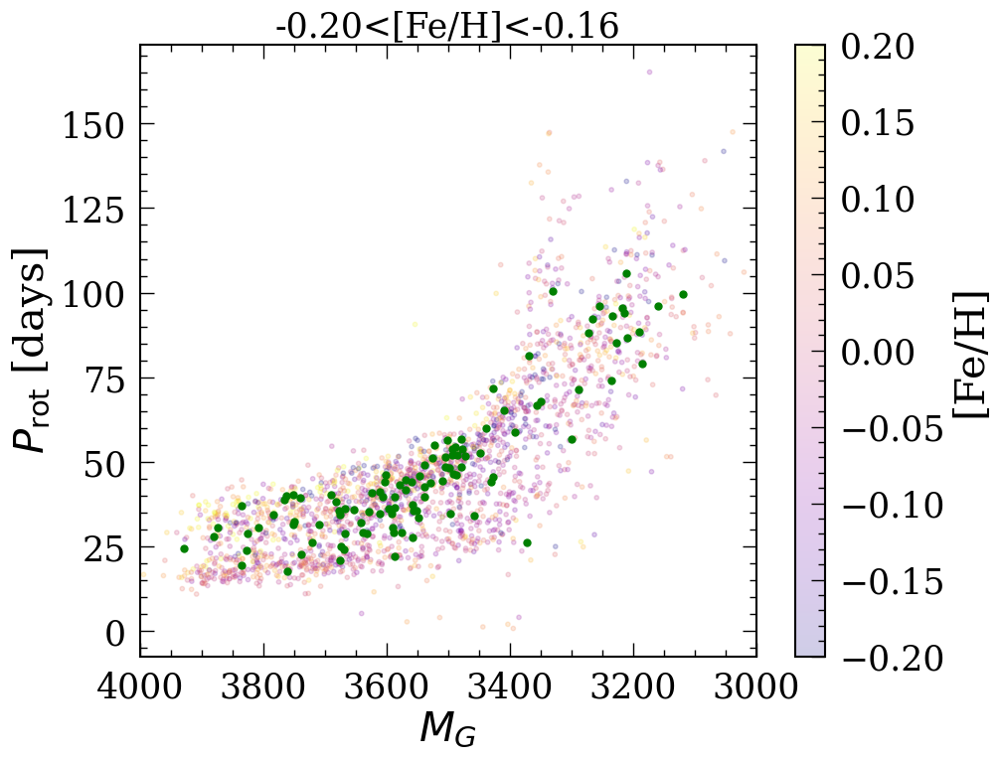

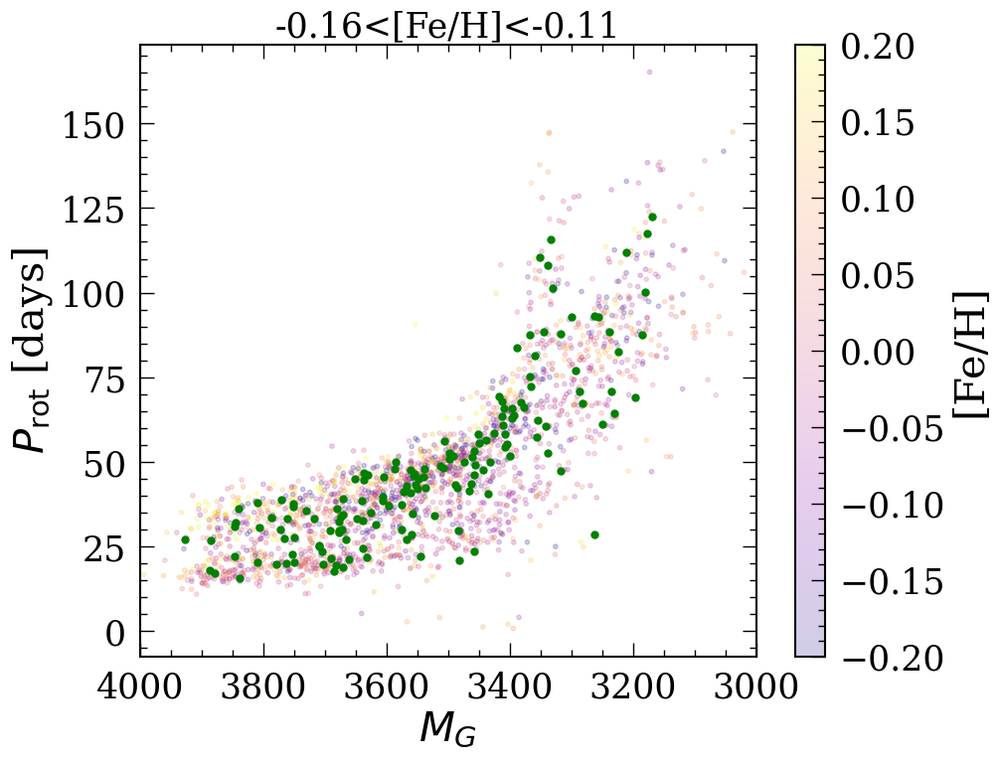

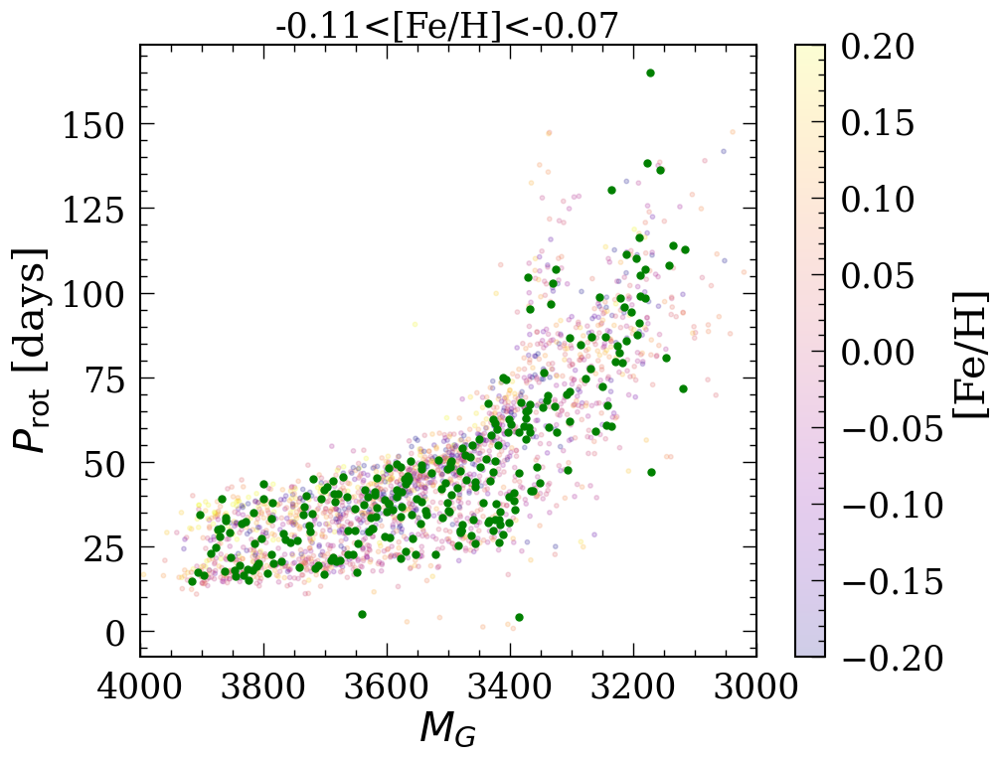

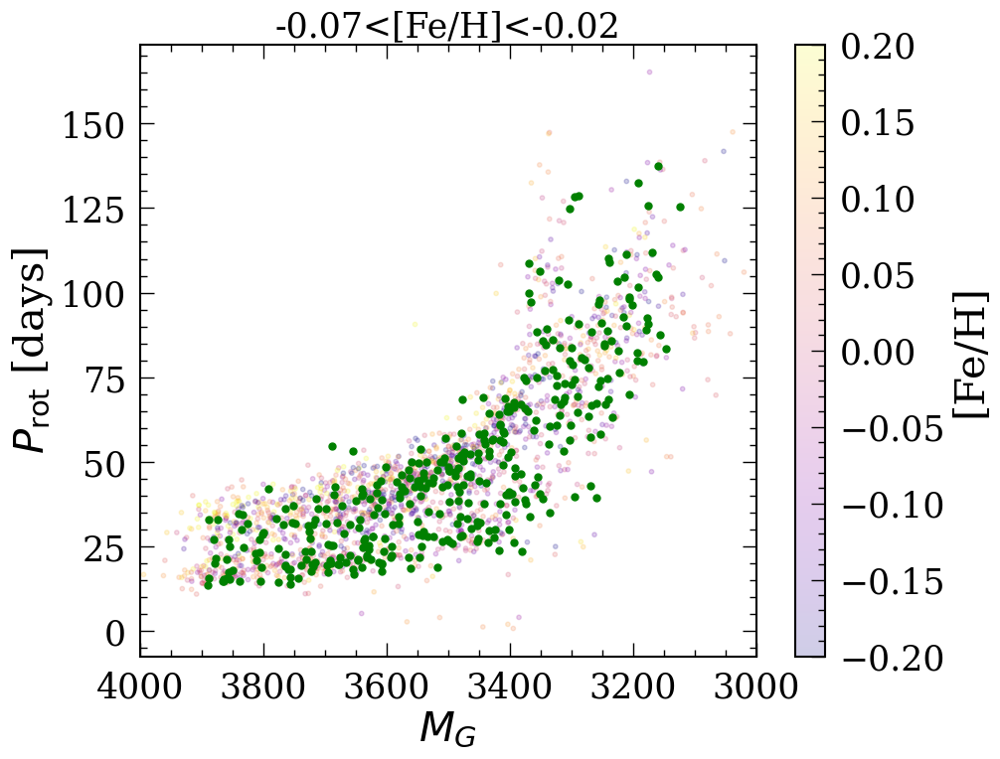

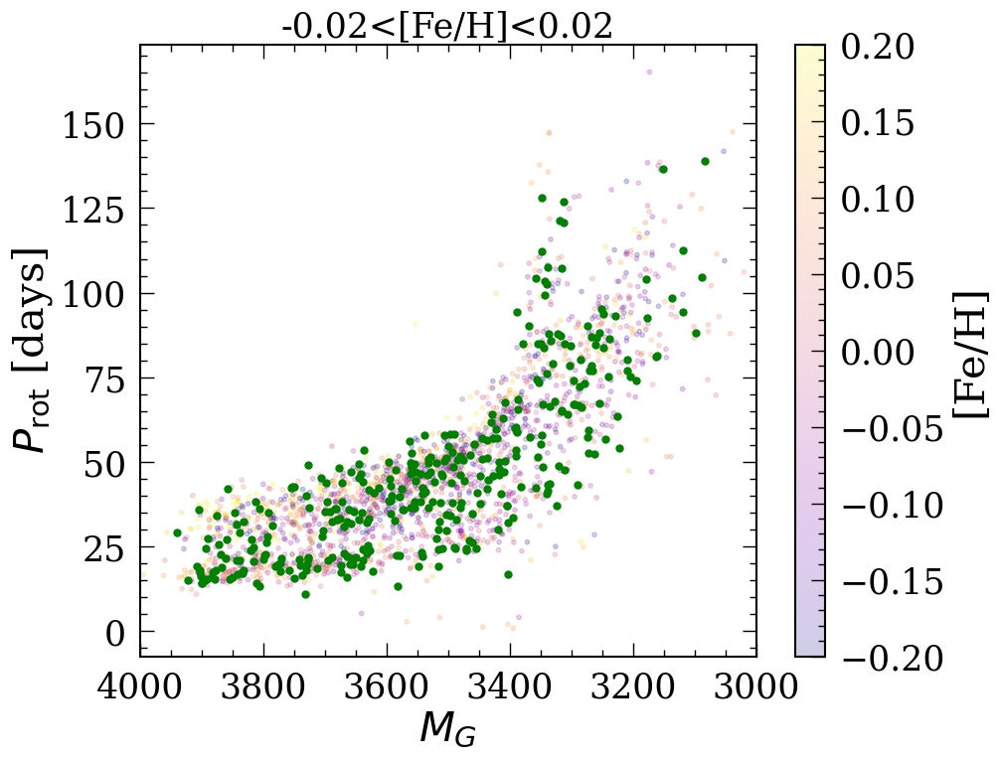

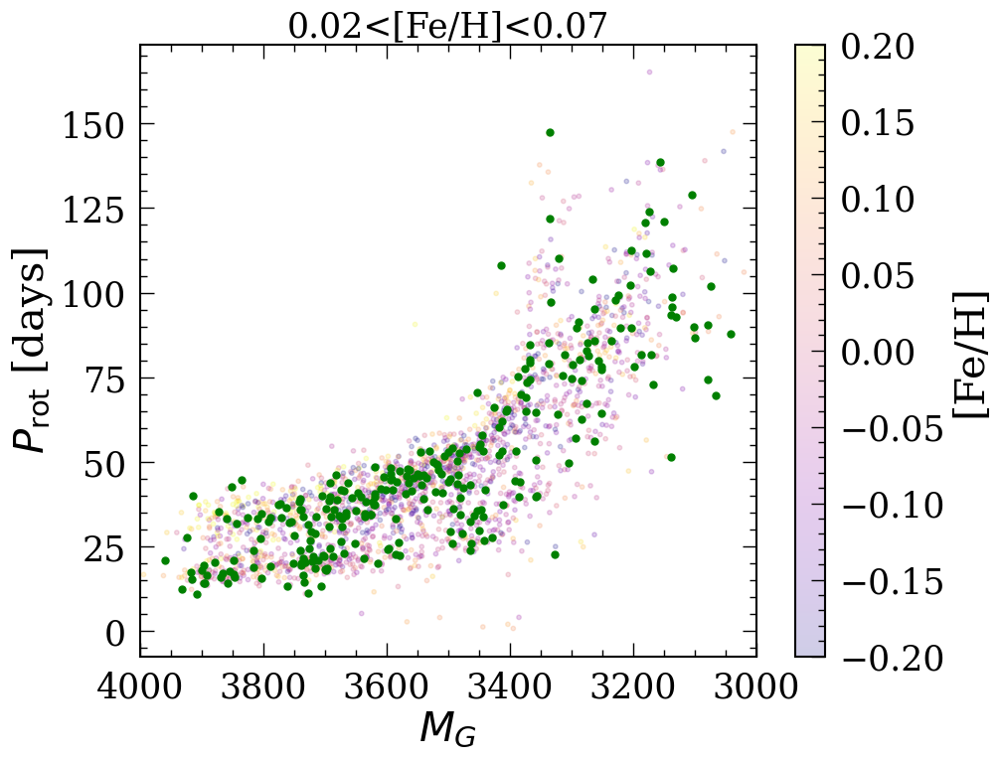

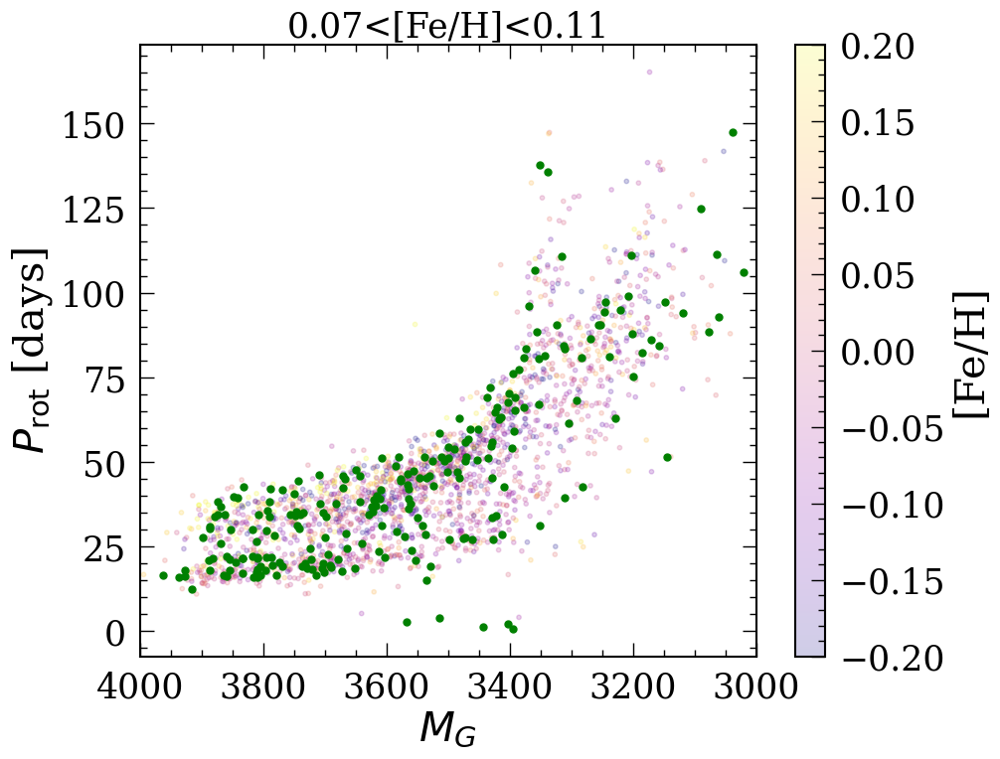

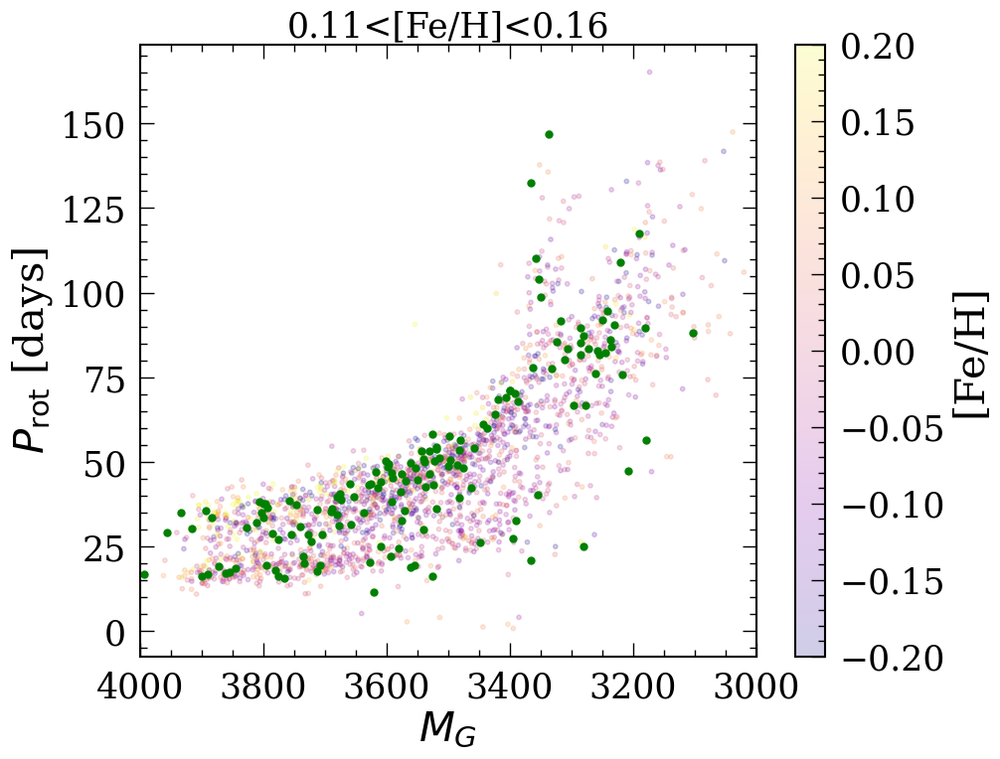

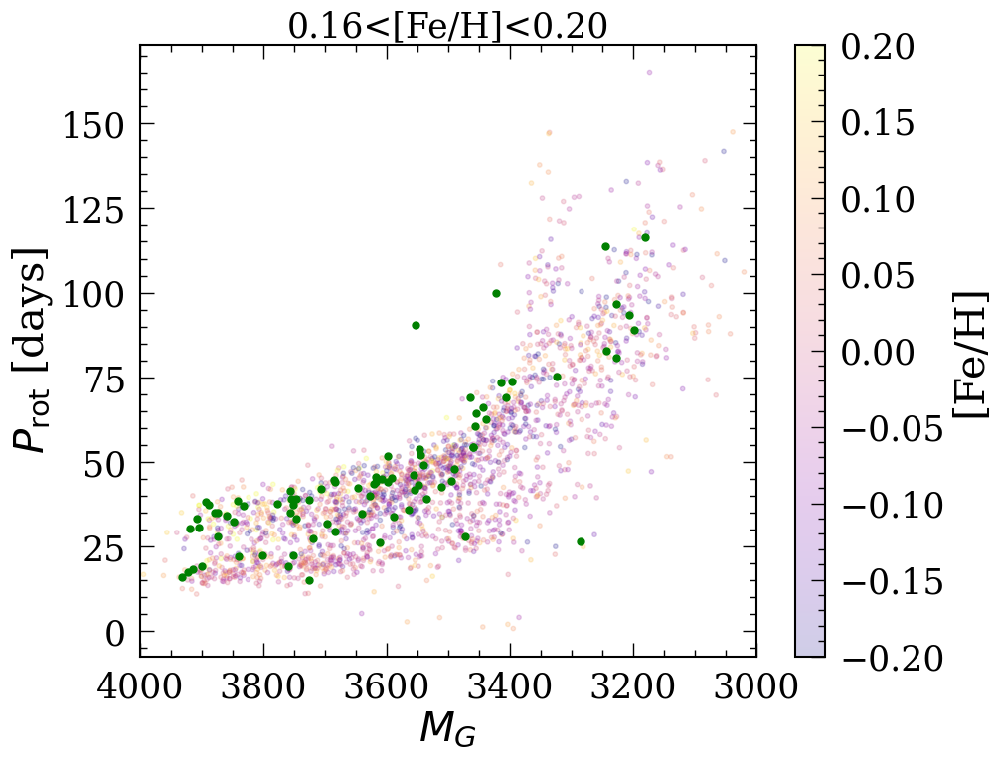

In [20]:
fehbin = np.linspace(-0.2,0.2,10)
for i in range(len(fehbin)-1):
    plt.figure(figsize=(10,8))
    plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['fe_h_cannon'], 
            vmin=-0.2, vmax=0.2, cmap='plasma', alpha=0.2)
    """plt.plot(ztf_old['abs_G'], ztf_old['Prot'], 'ko', markersize=15,
            zorder=1)
    plt.scatter(ztf_old['abs_G'], ztf_old['Prot'],
               c=ztf_old['fe_h_cannon'], cmap='plasma', zorder=2,
               vmin=-0.2, vmax=0.2)"""
    plt.xlim([4000, 3000])
    plt.xlabel('$M_G$')
    plt.ylabel('$P_{\\rm rot}$ [days]')
    plt.colorbar(label='[Fe/H]')
    m_ha = ((ZTF['fe_h_cannon']>fehbin[i])&(ZTF['fe_h_cannon']<fehbin[i+1]))
    plt.plot(ZTF['teff_y'][m_ha], ZTF['Prot'][m_ha], 'go', markersize=5)

    plt.title('%.2f<[Fe/H]<%.2f'%(fehbin[i], fehbin[i+1]), fontsize=25)

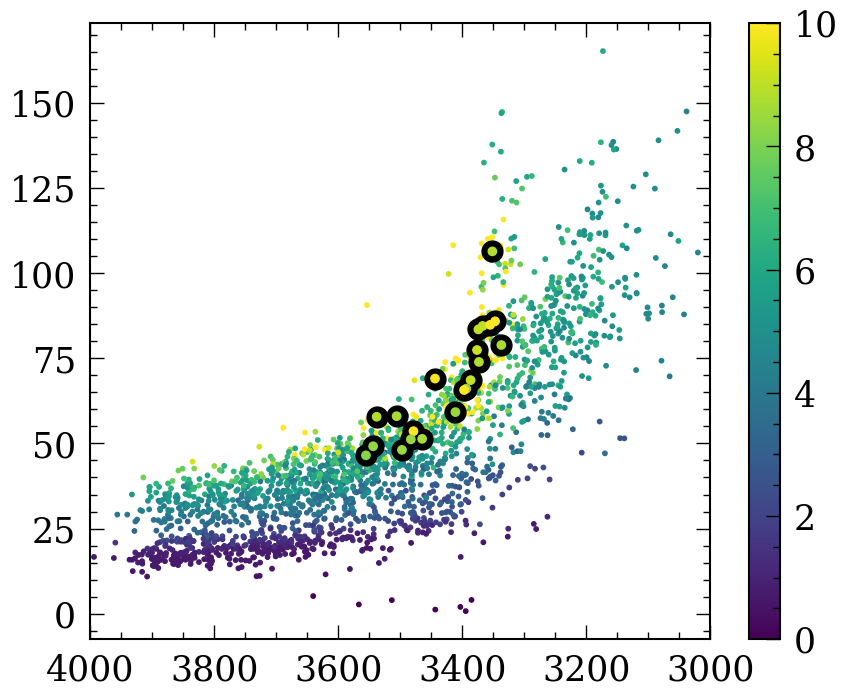

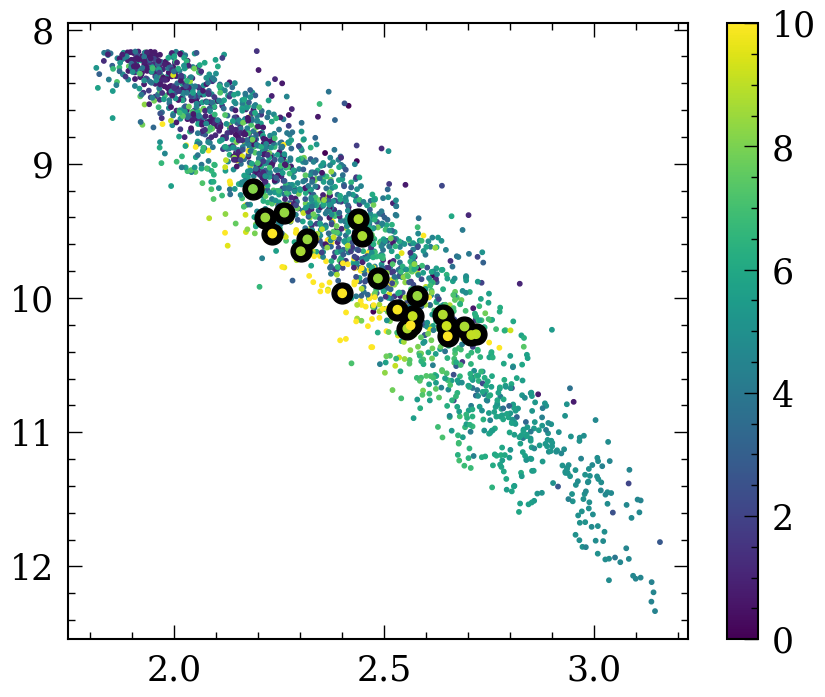

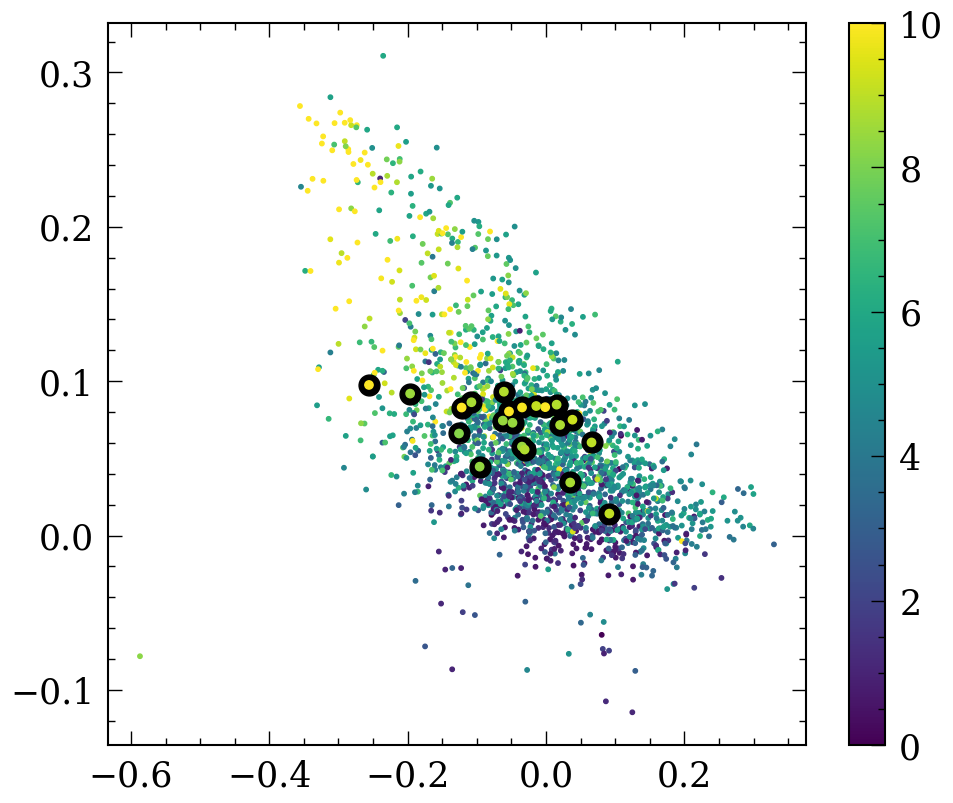

In [21]:
plt.figure(figsize=(10,8))
plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['teff_y'], ztf_old['Prot'], 'ko', markersize=15,
        zorder=1)
plt.scatter(ztf_old['teff_y'], ztf_old['Prot'],
           c=ztf_old['Age'], zorder=2,
           vmin=0, vmax=10)

plt.xlim([4000, 3000])
plt.colorbar()

plt.figure(figsize=(10,8))
plt.scatter(ZTF['bprp_dered'], ZTF['abs_G'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['bprp_dered'], ztf_old['abs_G'], 'ko', markersize=15,
        zorder=1)
plt.scatter(ztf_old['bprp_dered'], ztf_old['abs_G'],
            c=ztf_old['Age'], zorder=2,
            vmin=0, vmax=10)
plt.gca().invert_yaxis()
plt.colorbar()


plt.figure(figsize=(10,8))
plt.scatter(ZTF['fe_h_cannon'], 
            ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], 
            s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_old['fe_h_cannon'], 
             ztf_old['mg_h_cannon']-ztf_old['fe_h_cannon'], 
             'ko', markersize=15, zorder=1)
plt.scatter(ztf_old['fe_h_cannon'], 
             ztf_old['mg_h_cannon']-ztf_old['fe_h_cannon'], 
         c=ztf_old['Age'], zorder=2, vmin=0, vmax=10)
plt.tight_layout()
plt.colorbar()

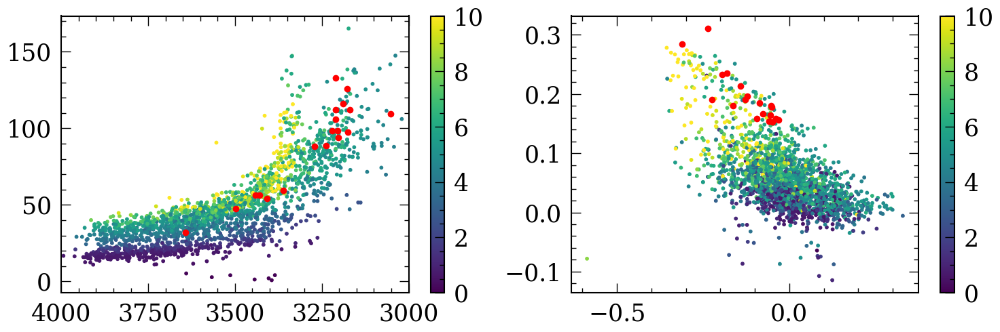

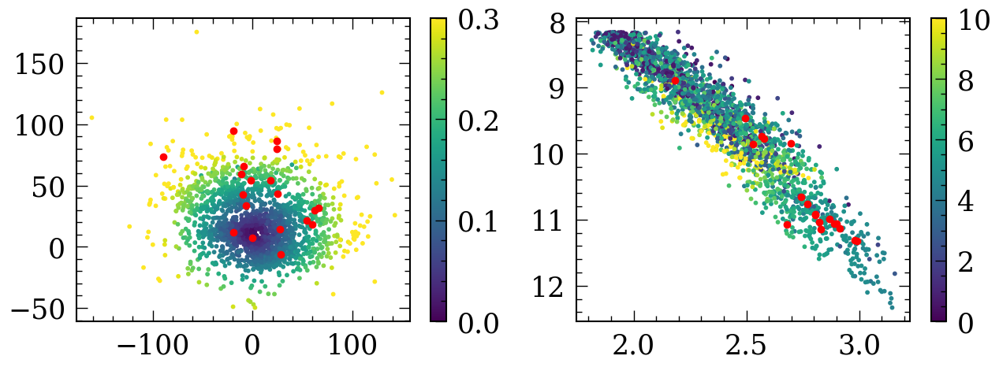

In [22]:
ztf_young = ZTF.loc[((ZTF['Age']>0)&(ZTF['Age']<7))&((ZTF['mg_h_cannon']-ZTF['fe_h_cannon'])>0.15)]
ZTF_confstar = [1334224001297142144, 2020319016539196544, 4477192832719229952, 
               668753419039280384, 3369714693425868416, 3267461726950039296,
               2258270821868517248, 2294257837445133952, 1512861552382148736, 
               1601180511077997440, 1657421389832154880, 1303413211585916928,
               1544939494884608256, 3926175054342271232, 1261101525951313280,
               1298666448089948288, 373817671224071168, 1093197239873399552,
               1329381820807744768]


ztf_young = ztf_young[ztf_young['source_id_x'].isin(ZTF_confstar)]

plt.figure(figsize=(15, 5))
plt.subplot(1,2,1)
plt.scatter(ZTF['teff_y'], ZTF['Prot'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_young['teff_y'], ztf_young['Prot'], 'ro')
plt.xlim([4000, 3000])
plt.colorbar()

plt.subplot(1,2,2)
plt.scatter(ZTF['fe_h_cannon'], ZTF['mg_h_cannon']-ZTF['fe_h_cannon'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_young['fe_h_cannon'], ztf_young['mg_h_cannon']-ztf_young['fe_h_cannon'], 'ro')
plt.tight_layout()
plt.colorbar()

plt.figure(figsize=(15, 5))
plt.subplot(1,2,1)
plt.scatter(ZTF['vr'], ZTF['vphi']+240, s=10, c=ZTF['e'], 
            vmin=0, vmax=0.3)
plt.plot(ztf_young['vr'], ztf_young['vphi']+240, 'ro')
plt.colorbar()

plt.subplot(1,2,2)
plt.scatter(ZTF['bprp_dered'], ZTF['abs_G'], s=10, c=ZTF['Age'], 
            vmin=0, vmax=10)
plt.plot(ztf_young['bprp_dered'], ztf_young['abs_G'], 'ro')
plt.gca().invert_yaxis()
plt.colorbar()

In [23]:
"""plt.scatter(ZTF['Prot'], ZTF['v_sini'], c=ZTF['teff_y'], 
           vmin=3000, vmax=4000)
plt.yscale('log')
plt.xlabel('$P_{\\rm rot}$ [Days]')
plt.ylabel('$v$sin($i$) [km/s]')"""

"plt.scatter(ZTF['Prot'], ZTF['v_sini'], c=ZTF['teff_y'], \n           vmin=3000, vmax=4000)\nplt.yscale('log')\nplt.xlabel('$P_{\\rm rot}$ [Days]')\nplt.ylabel('$v$sin($i$) [km/s]')"

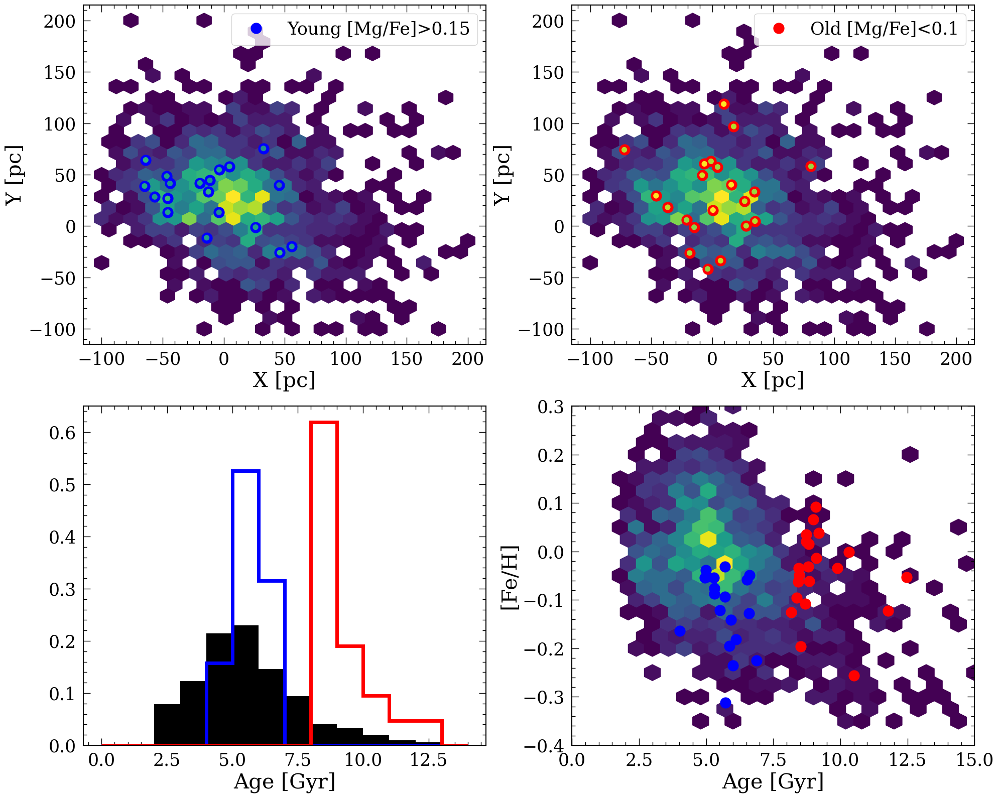

In [24]:
elements = [i for i in ZTF.columns if '_h_cannon' in i and 'raw' not in i and 'flags' not in i and 'chi2' not in i and 'pk' not in i and 'e_' not in i]
m2 = (ZTF['Age']>2)
sx = 8.14
plt.figure(figsize=(20,16))
plt.subplot(2,2,1)
plt.hexbin((-ZTF['x']-sx)[m2]*1000, ZTF['y'][m2]*1000, 
            extent=(-100, 200, -100, 200), mincnt=1,
          gridsize=25)
plt.plot((-ztf_young['x']-sx)*1000, ztf_young['y']*1000, 'bo', ms=15, zorder=1,
        label='Young [Mg/Fe]>0.15')
plt.scatter((-ztf_young['x']-sx)*1000, ztf_young['y']*1000, 
            c=ztf_young['Age'], zorder=2,
           vmin=0, vmax=10, s=50)
plt.legend(frameon=True)
plt.xlabel('X [pc]')
plt.ylabel('Y [pc]')


plt.subplot(2,2,2)
"""plt.scatter((-ZTF['x']-sx)[m2]*1000, ZTF['y'][m2]*1000, 
            c=ZTF['Age'][m2], vmin=0, vmax=10, s=10, zorder=1)"""
plt.hexbin((-ZTF['x']-sx)[m2]*1000, ZTF['y'][m2]*1000, 
            extent=(-100, 200, -100, 200), mincnt=1,
          gridsize=25)
plt.plot((-ztf_old['x']-sx)*1000, ztf_old['y']*1000, 'ro', ms=15, zorder=1,
        label='Old [Mg/Fe]<0.1')
plt.scatter((-ztf_old['x']-sx)*1000, ztf_old['y']*1000, 
            c=ztf_old['Age'], zorder=2, s=50,
           vmin=0, vmax=10)
plt.legend(frameon=True)
plt.xlabel('X [pc]')
plt.ylabel('Y [pc]')

plt.subplot(2,2,3)
plt.hist(ZTF['Age'][m2], color='k', bins=np.linspace(0,14,15), density=True)
plt.hist(ztf_young['Age'], color='b', histtype='step',
        bins=np.linspace(0,14,15), linewidth=5, density=True)
plt.hist(ztf_old['Age'], color='r', histtype='step',
        bins=np.linspace(0,14,15), linewidth=5, density=True)
plt.xlabel('Age [Gyr]')


plt.subplot(2,2,4)
"""plt.scatter(ZTF['Age'][m2], 
            ZTF['fe_h_cannon'][m2], 
            s=10, c=(ZTF['mg_h_cannon']-ZTF['fe_h_cannon'])[m2], 
            vmin=0, vmax=0.2)"""
plt.hexbin(ZTF['Age'][m2], 
            ZTF['fe_h_cannon'][m2], 
            mincnt=1, extent=(0, 15, -0.4, 0.3), gridsize=25)
plt.plot(ztf_old['Age'], 
             ztf_old['fe_h_cannon'], 
             'ro', markersize=15, zorder=1)
plt.plot(ztf_young['Age'], 
             ztf_young['fe_h_cannon'], 
             'bo', markersize=15, zorder=1)
plt.xlim([0,15])
plt.ylim([-0.4, 0.3])
plt.tight_layout()
plt.xlabel('Age [Gyr]')
plt.ylabel('[Fe/H]')

plt.tight_layout()

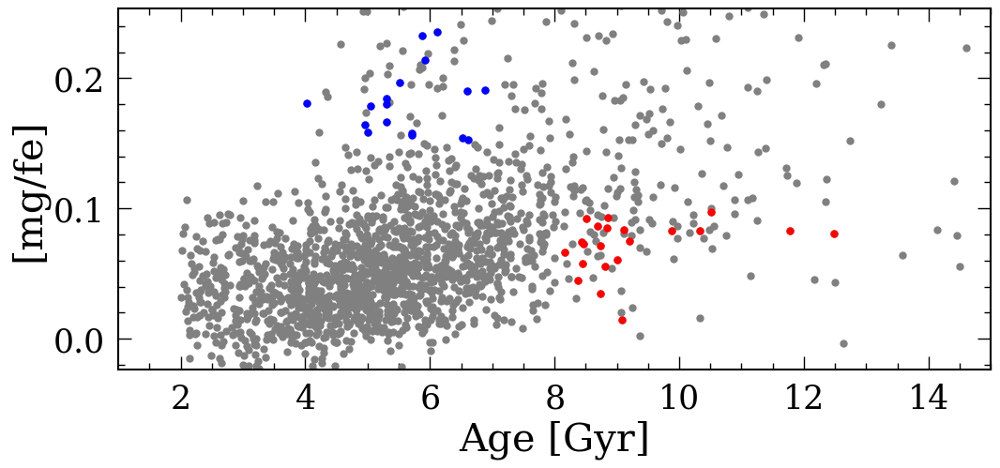

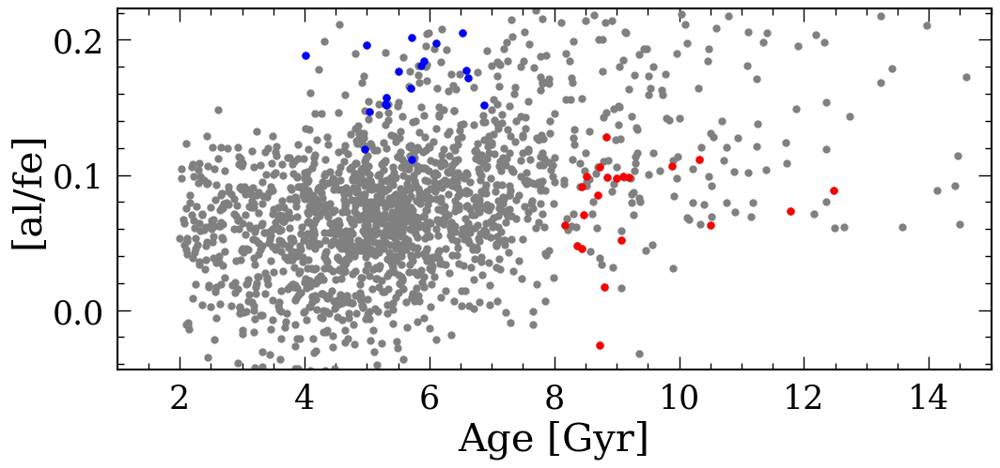

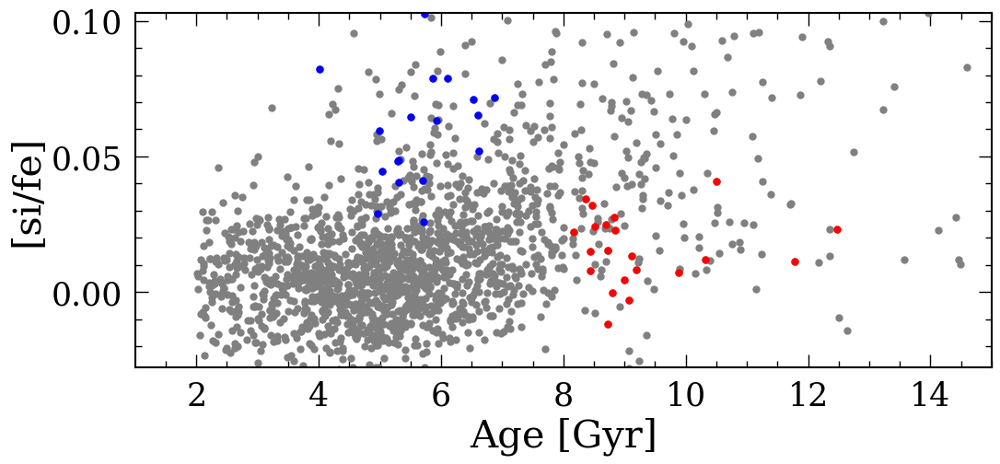

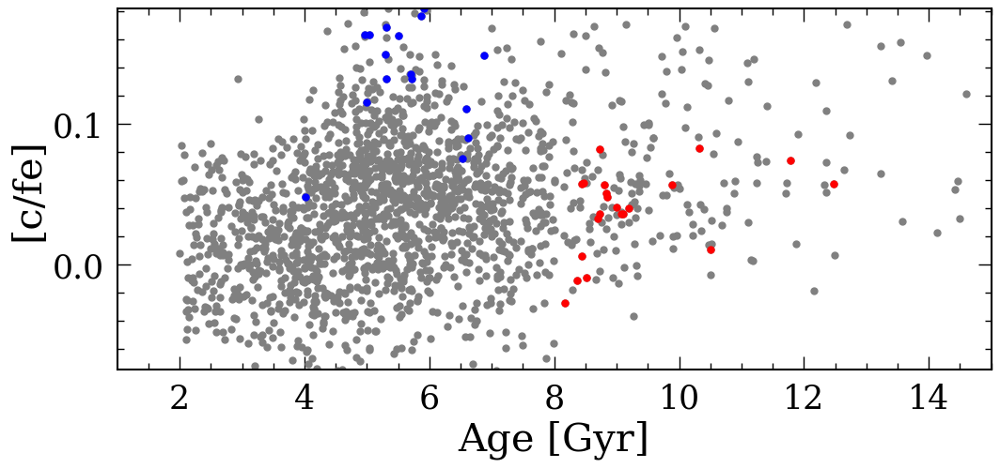

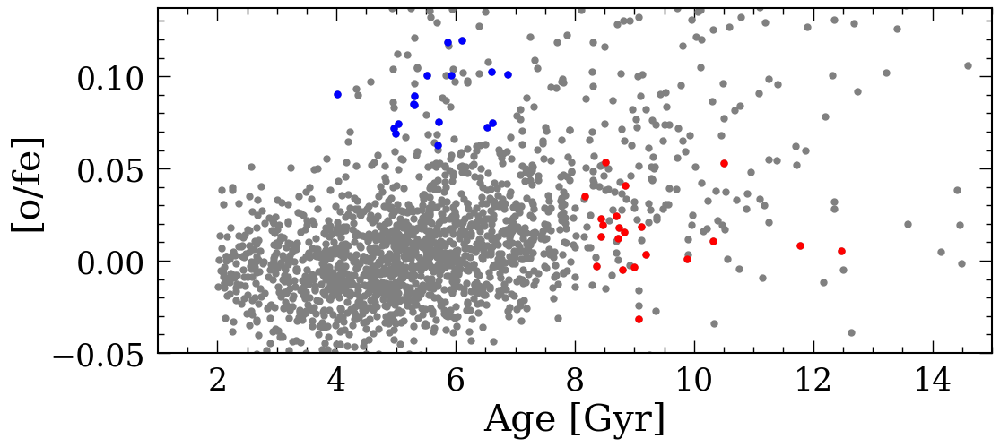

...

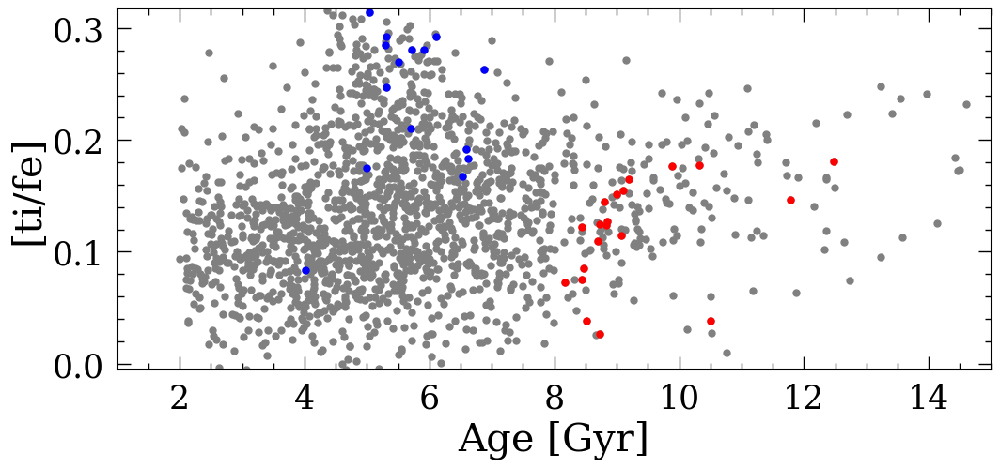

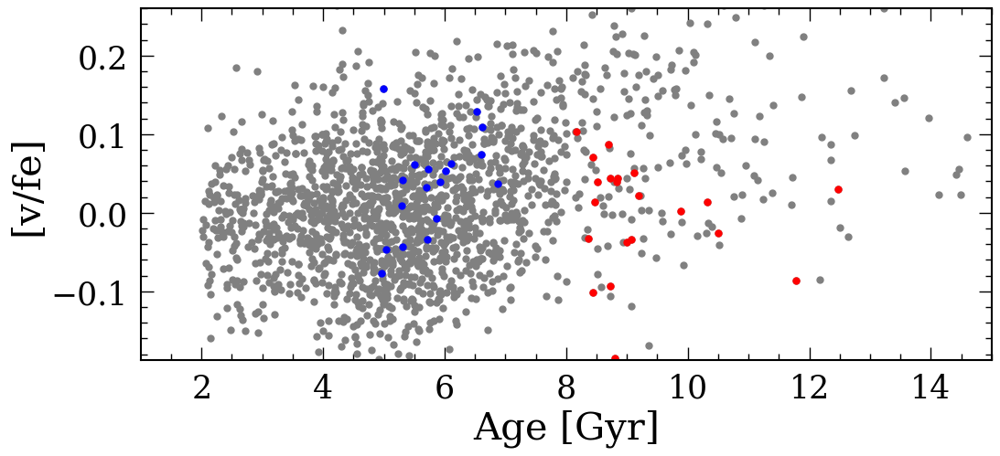

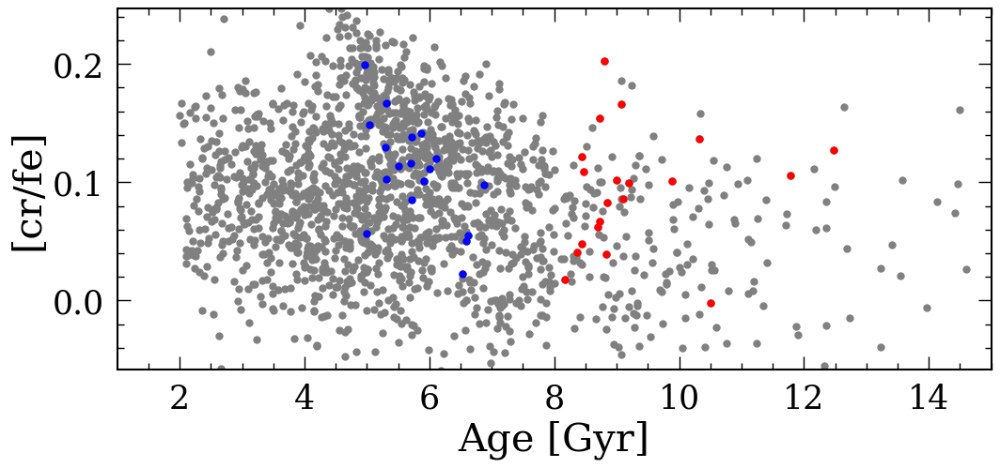

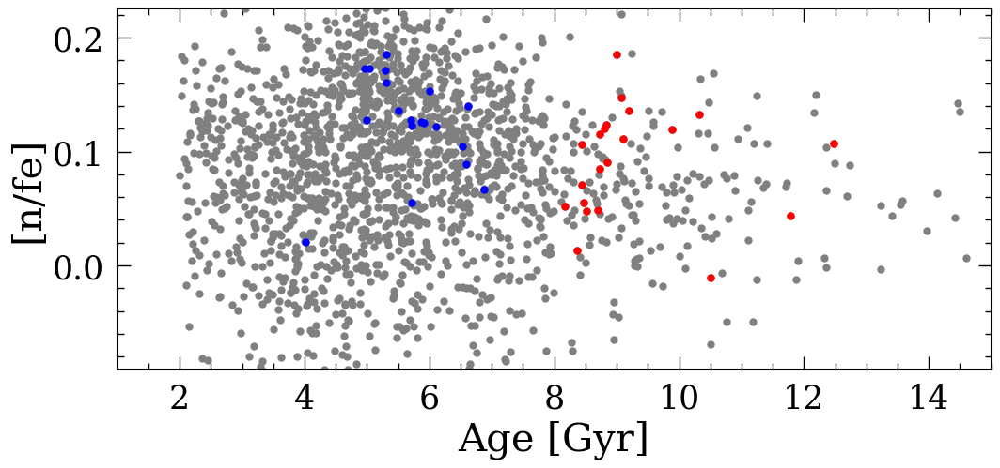

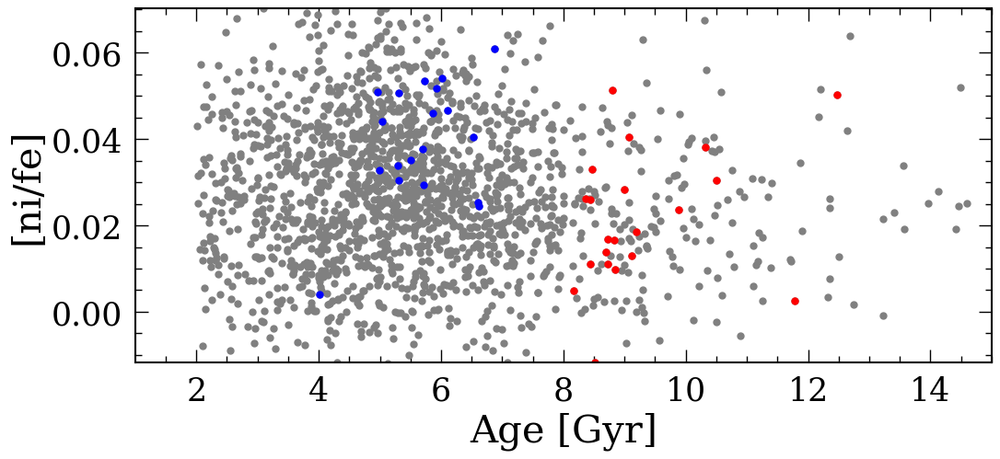

In [25]:
m2 = (ZTF['Age']>2)
for i in range(len(elements)):
    ele = ZTF[elements[i]]
    if len(ele.dropna())==0:
        continue
   
    plt.figure(figsize=(12,5))
    eleplot = ZTF[elements[i]][m2]-ZTF['fe_h_cannon'][m2]
    plt.plot(ZTF['Age'][m2], eleplot, 'o', color='grey',
            ms=5)
    plt.plot(ztf_young['Age'], ztf_young[elements[i]]-ztf_young['fe_h_cannon'][m2], 'bo',
            ms=5)
    plt.plot(ztf_old['Age'], ztf_old[elements[i]]-ztf_old['fe_h_cannon'][m2], 'ro',
            ms=5)
    plt.xlabel('Age [Gyr]')
    plt.ylabel('['+elements[i].split('_h')[0]+'/fe]')
    plt.xlim([1, 15])
    
    plt.ylim([np.percentile(eleplot, 1), np.percentile(eleplot, 99)])
    
    
    

In [26]:
ZTF_planet = pd.read_csv('../NewGyroKineage/Tab3.csv')
ZTF_planet = ZTF_planet.dropna(subset=['gaia_id'])

In [27]:
ZTF_planet['source_id'] = [int(i.split('Gaia DR2 ')[-1]) for i in ZTF_planet['gaia_id']]

In [28]:
ZTF_planet = pd.merge(ZTF_planet, df, left_on='source_id',
               right_on='gaia_dr2_source_id', how='inner')
print(len(ZTF_planet))

15


/var/folders/w0/h14c78gj4rs91wsbcjh87y2m0000gn/T/ipykernel_29348/2434254201.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ZTF_planet['mg_fe'] = ZTF_planet['mg_h']-ZTF_planet['fe_h']


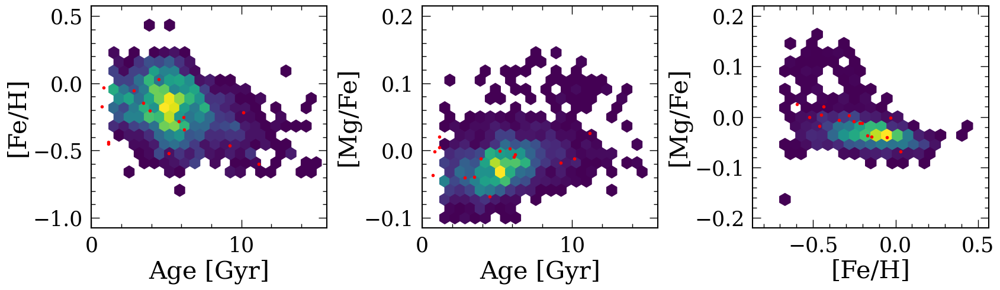

In [29]:
plt.figure(figsize=(17,5))
plt.subplot(1,3,1)
plt.hexbin(ZTF['Age'], ZTF['fe_h'],
          extent=(1.5, 15, -1, 0.5), mincnt=1,
          gridsize=20)
plt.plot(ZTF_planet['Age'], ZTF_planet['fe_h'], 'r.')
plt.xlabel('Age [Gyr]')
plt.ylabel('[Fe/H]')

plt.subplot(1,3,2)
ZTF['mg_fe'] = ZTF['mg_h']-ZTF['fe_h']
ZTF_planet['mg_fe'] = ZTF_planet['mg_h']-ZTF_planet['fe_h']
df['mg_fe'] = df['mg_h'] - df['fe_h']

plt.hexbin(ZTF['Age'], ZTF['mg_fe'],
          extent=(1.5, 15, -0.1, 0.2), mincnt=1,
          gridsize=20)
plt.plot(ZTF_planet['Age'], ZTF_planet['mg_fe'], 'r.')
plt.xlabel('Age [Gyr]')
plt.ylabel('[Mg/Fe]')

plt.subplot(1,3,3)
"""plt.hexbin(df['fe_h'][(df['logg']>4)&(df['teff']>4500)], 
           df['alpha_m_atm'][(df['logg']>4)&(df['teff']>4500)],
          extent=(-0.8, 0.5, -0.1, 0.2), mincnt=1,
          gridsize=50, cmap='binary')"""
#plt.colorbar()
plt.hexbin(ZTF['fe_h'], ZTF['alpha_m_atm'],
          extent=(-0.8, 0.5, -0.2, 0.2), mincnt=1,
          gridsize=20)
plt.plot(ZTF_planet['fe_h'], ZTF_planet['mg_fe'], 
           'r.')
plt.xlabel('[Fe/H]')
plt.ylabel('[Mg/Fe]')
plt.tight_layout()

In [30]:
9.965748e-01  

0.9965748

In [31]:
#ZTF.to_csv('GPGyro_Aida_Mdwarf_abund_ZTF_Kepler.csv', index=False)

In [32]:
planet = pd.read_csv('PS_2024.08.08_08.34.15.csv', skiprows=107)
planet = pd.merge(planet, ZTF_planet, left_on='hostname', right_on='hostname',
                 how='inner')

In [33]:
count=0
for i in range(len(planet)):
    try:
        int((planet['gaia_id'].iloc[i]).split('Gaia DR2 ')[-1])
    except:
        count=count+1
        #print(planet['gaia_id'].iloc[i])
#print(count)

In [34]:
len(planet['hostname'].unique())

14

In [35]:
"""planet = pd.read_csv('PS_2024.10.23_07.34.35.csv', skiprows=99)
planet = planet.dropna(subset=['gaia_id'])
planet = planet.loc[~np.array(['Gaia-' in i for i in planet['gaia_id']], dtype=bool)]
planet['source_id'] = [int(i.split('Gaia DR2 ')[-1]) for i in planet['gaia_id']]
planet = pd.merge(planet, ZTF, left_on='source_id', right_on='gaia_dr2_source_id',
                 how='inner')
len(planet['hostname'].unique())"""

"planet = pd.read_csv('PS_2024.10.23_07.34.35.csv', skiprows=99)\nplanet = planet.dropna(subset=['gaia_id'])\nplanet = planet.loc[~np.array(['Gaia-' in i for i in planet['gaia_id']], dtype=bool)]\nplanet['source_id'] = [int(i.split('Gaia DR2 ')[-1]) for i in planet['gaia_id']]\nplanet = pd.merge(planet, ZTF, left_on='source_id', right_on='gaia_dr2_source_id',\n                 how='inner')\nlen(planet['hostname'].unique())"

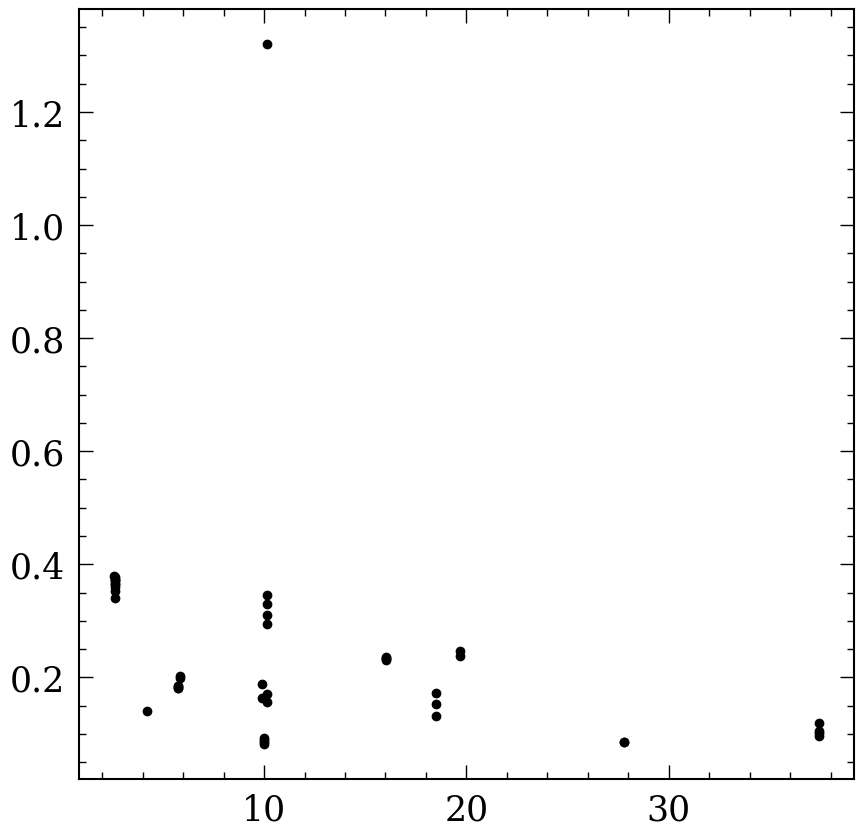

In [36]:
plt.plot(planet['pl_orbper'], planet['pl_radj'], 'ko')

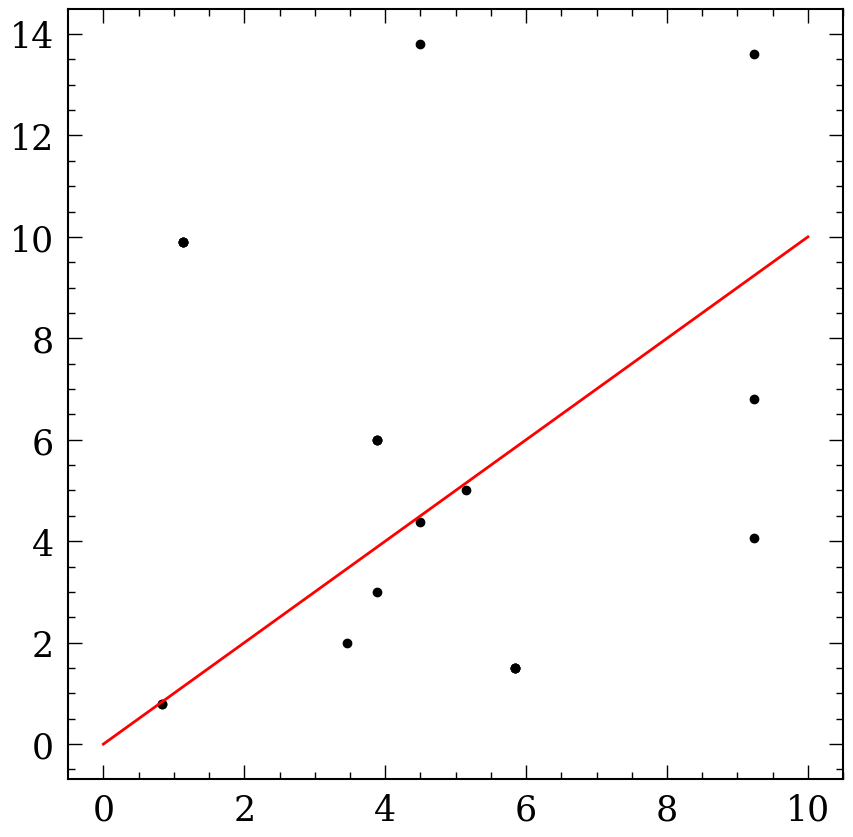

In [37]:
planet = planet.dropna(subset='Age')
plt.plot(planet['Age'], planet['st_age'], 'ko')
plt.plot([0, 10], [0, 10], 'r-')

In [38]:
elements = [i for i in ZTF.columns if '_h_cannon' in i and 'raw' not in i and 'flags' not in i and 'chi2' not in i and 'pk' not in i and 'e_' not in i]
len(elements)

11

In [39]:
planet['SE'] = ((planet['pl_rade']<4)&(planet['pl_orbper']<100))
planet['HWJ'] = ((planet['pl_rade']>4)&(planet['pl_orbper']<100))
planet['type'] = planet['SE']*2+planet['HWJ']
print(len(planet), sum(planet['SE']), sum(planet['HWJ']))

93 51 9


9 51


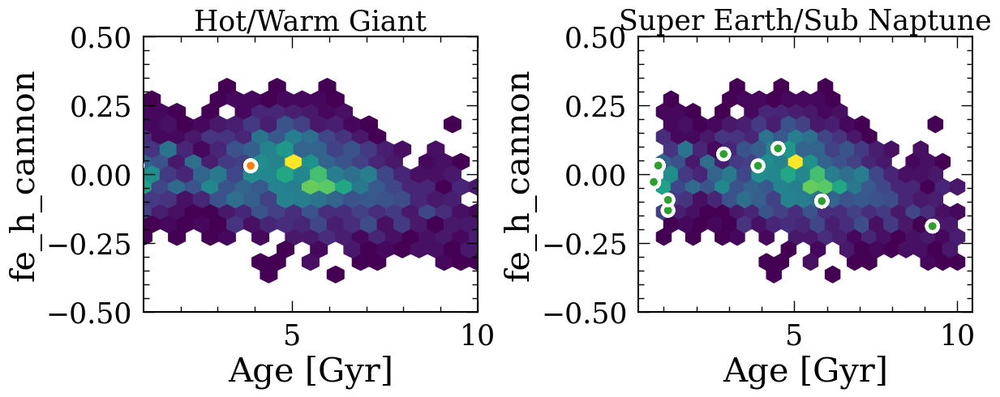

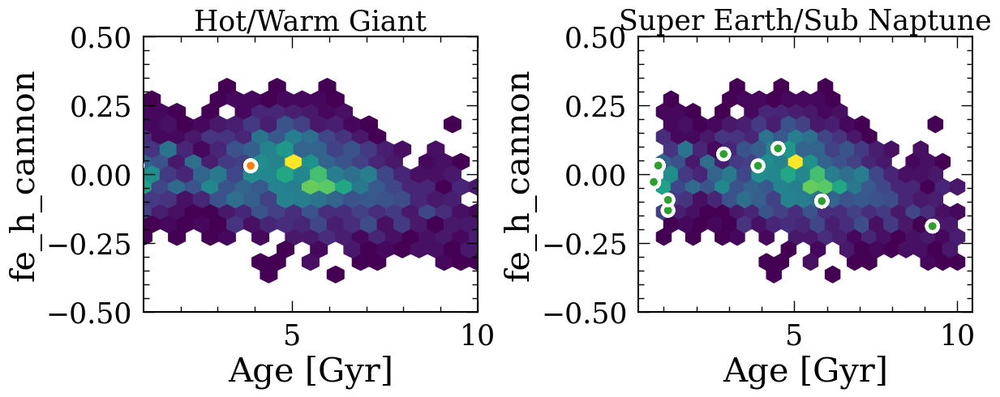

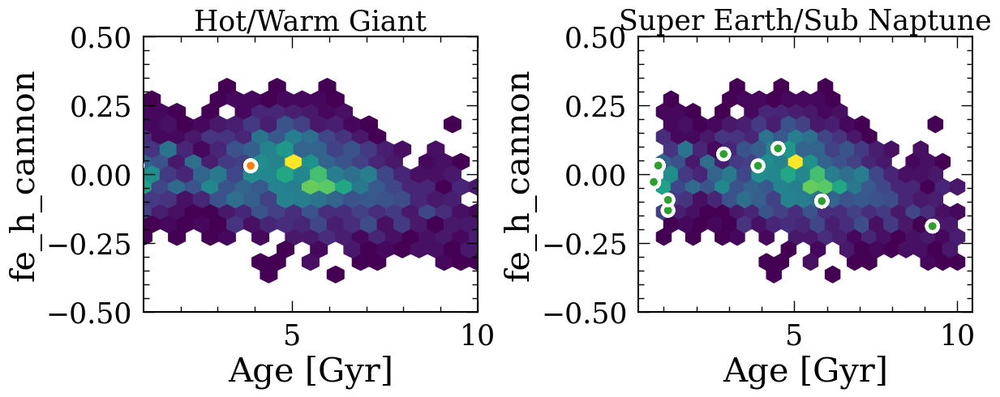

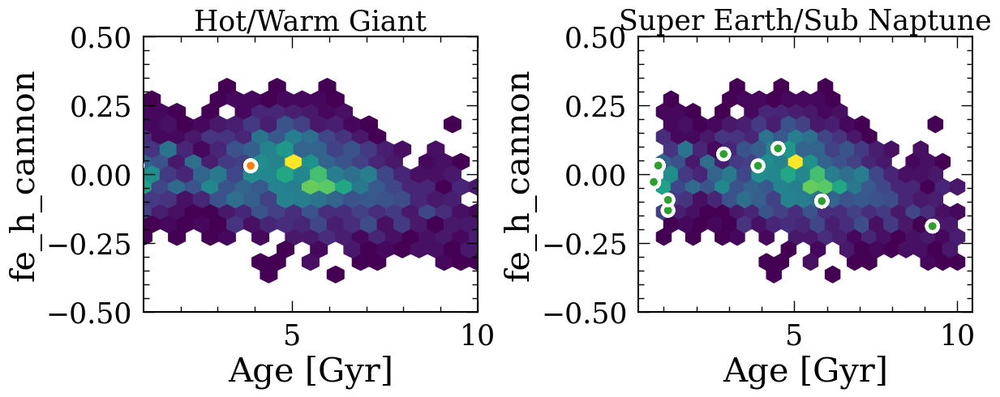

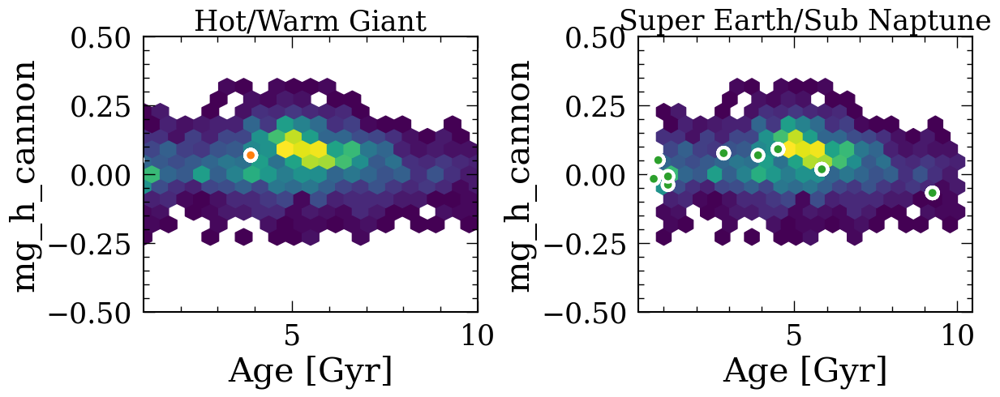

...

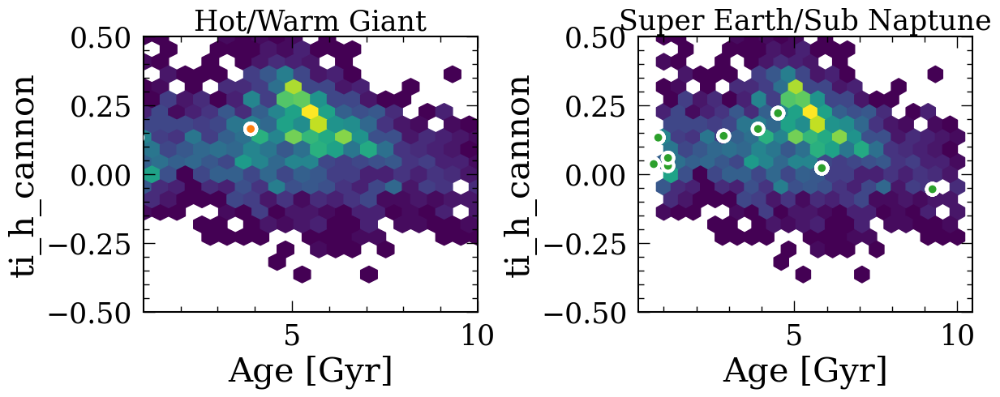

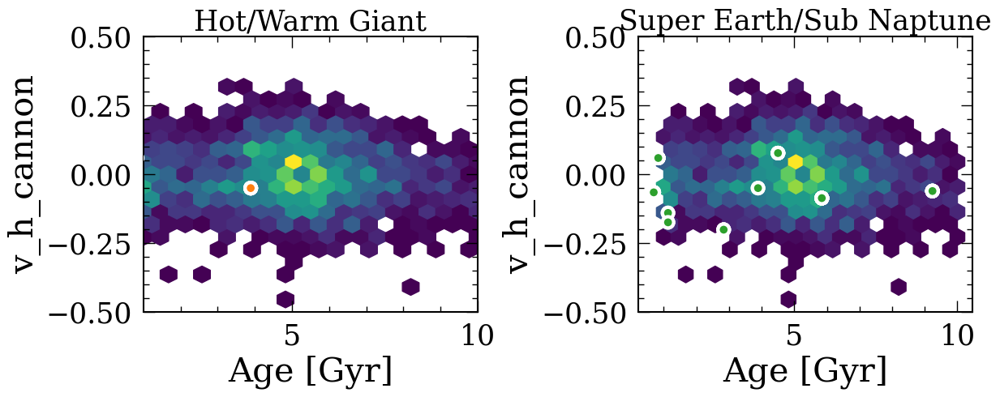

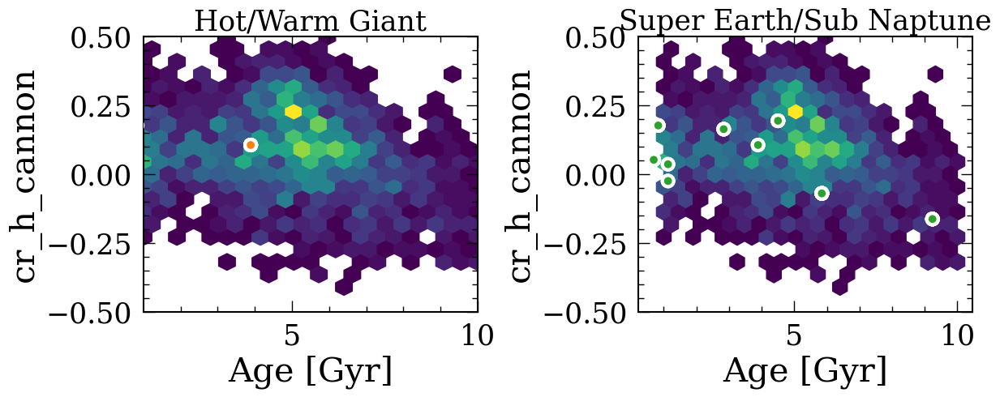

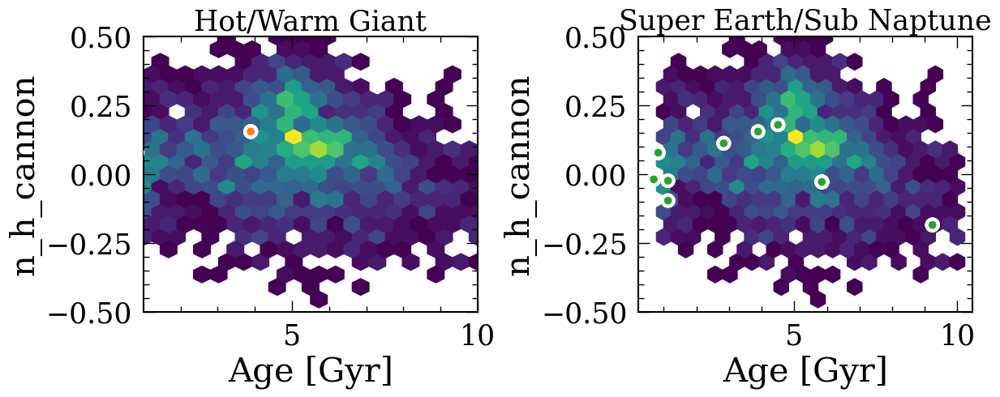

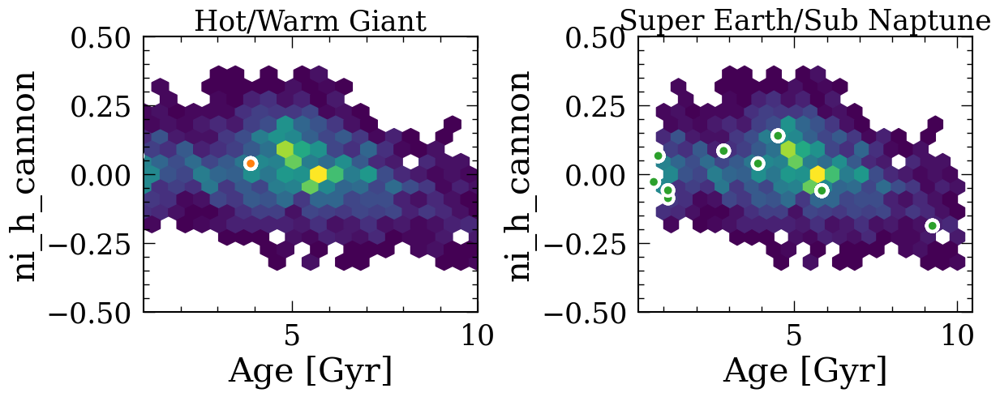

In [43]:
m4 = ((planet['type']==1)|(planet['type']==3))
m5 = ((planet['type']==2)|(planet['type']==3))
print(sum(m4), sum(m5))

elements = np.append(['fe_h_cannon'], elements)

for i in range(len(elements)):
    ele = ZTF[elements[i]]
    if len(ele.dropna())==0:
        continue
   
    plt.figure(figsize=(12,5))
    plt.subplot(1,2,1)
    plt.hexbin(ZTF['Age'], ZTF[elements[i]],
              extent=(1, 10, -0.5, 0.5), mincnt=1,
              gridsize=20, zorder=1)
    plt.scatter(planet['Age'][m4], planet[elements[i]][m4], 
                c=planet['type'][m4], zorder=3, edgecolor='w', linewidth=3,
               s=100, cmap='tab10', vmin=0, vmax=10)
    plt.xlabel('Age [Gyr]')
    plt.ylabel(elements[i])
    plt.xlim([1,10])
    plt.ylim([-0.5, 0.5])
    plt.title('Hot/Warm Giant', fontsize=25)
    
    plt.subplot(1,2,2)
    ele = ZTF[elements[i]]
    if len(ele.dropna())==0:
        continue
   
    plt.hexbin(ZTF['Age'], ZTF[elements[i]],
              extent=(1, 10, -0.5 , 0.5), mincnt=1,
              gridsize=20, zorder=1)
    plt.scatter(planet['Age'][m5], planet[elements[i]][m5], 
                c=planet['type'][m5], zorder=3, edgecolor='w', linewidth=3,
               s=100, cmap='tab10', vmin=0, vmax=10)
    plt.xlabel('Age [Gyr]')
    plt.ylabel(elements[i])
    plt.ylim([-0.5, 0.5])
    #plt.xlim([1,10])
    plt.title('Super Earth/Sub Naptune', fontsize=25)
    #plt.ylim([np.percentile((ZTF[elements[i]]).dropna(), 1), np.percentile((ZTF[elements[i]]).dropna(), 99)])
    plt.tight_layout()